# Earthquake Data Analysis

### Description

The catalog includes the magnitude, time of occurrence (s), and 3D coordinates (m) of earthquakes in about 20 years of recording in South California. Coordinates were converted from latitude, longitude, and depth of events in a seismic catalog. Magnitudes should be within the range $[0,8]$.

* **Waiting time (t)**: time interval between an event and the next one in the sequence.
* **Distance (r)**: Eucledian 3D distance between events. (each 3D set of coordinates refers to the hypocenter, i.e. the point triggering the slip in a fault that forms the earthquake)


### Assignments

1. Deduce what is the variable in each column of the catalog.
2. Visualize the process in space and/or time with suitable time series and/or 3D visualizations of the hypocenters. For instance, plot a space variable (a single coordinate or a nice linear combination of coordinates) as a function of time.
3. Compute the distribution $P_m(t)$ of waiting times for events of magnitude m or above (i.e. do not consider events below $m$). In shaping the bin sizes, take into account that this distribution is expected to have a power-law decay with time (e.g $\sim 1/t$), and that a power-law is well visualized in log-log scale. Do this analysis for many values of $m$, say $m=2,3,4,5$.
4. Compute the distribution $P_m(r)$ of the distance between an event and the next one, considering earthquakes of magnitude m or above. Also here make a clever choice for the bin sizes and try several values of $m$.
5. Compute the distribution $P_{m,R}(t)$ of waiting times for events of magnitude $m$ or above, which are separated by at most a distance $r<R$, for different values of m and $R$. (In this statistics, if the following event is farther than $R$, skip the $t$ and go to the next pair)
6. Eventually note if, from the analysis of the previous points, there emerges a scaling picture. Is there a suitable rescaling that collapses distributions for various $m$ (and eventually $R$ if point 5 is considered) on a single curve?

### Datasets

* column 1: index of the event
* column 2: index of the previous event that triggered it (defined with a given algorithm), -1 if no ancestor is found
* column 3: time (seconds) from 0:00 of Jan.1st, 1982
* column 4: magnitude
* columns 5, 6, and 7: 3D coordinates (meters) of the earthquake hypocenter, i.e. of the point from where it started. These Euclidean coordinates are derived from latitude, longitude and depth.

Joining each event to that with the index of the second column (if not -1), there emerges a set of causal trees.


### Contact
* Marco Baiesi <marco.baiesi@unipd.it>

# 1. Data Acquisition

We load the given dataset, organize it in a pandas DataFrame and assign a name to each column.

In [ ]:
# google colab upload link, to be omitted when working on Jupyter Notebook
from google.colab import drive
drive.mount('/content/drive')
filepath = '/content/drive/MyDrive/LCP_project/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import plotly.express as px
import matplotlib as mpl
from matplotlib.colors import LinearSegmentedColormap, ListedColormap
from matplotlib.cm import ScalarMappable
import seaborn as sns
import numpy.linalg as la
import seaborn as sns
from astropy.stats import knuth_bin_width as knuth
from scipy.stats import chi2
from scipy.optimize import curve_fit
from scipy.fftpack import fft, ifft
import networkx as nx
!apt install libgraphviz-dev
!pip install pygraphviz
import graphviz

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
libgraphviz-dev is already the newest version (2.42.2-6).
0 upgraded, 0 newly installed, 0 to remove and 33 not upgraded.


In [ ]:
data = 'SouthCalifornia-1982-2011_Physics-of-Data.dat'

We can see that the provided data includes the single earthquake event index, the event from which it is generated, the time variable of data acquisition and the three spatial coordinates of the event's hypocenter (x, y, z).

Specifically, the origin of our frame of reference is the center of the Earth, while the z axis is along the N-S direction and the x direction is on the plane of the equator, passing through the Greenwhich meridian (0°).

In [ ]:
# google colab command
df = pd.read_csv(filepath + data, sep = ' ', names = ['Index', 'Prev_event', 'Time', 'Magnitude', 'x', 'y', 'z'])

# Jupyter Notebook command
# df = pd.read_csv(data, sep = ' ', names = ['Index', 'Prev_event', 'Time', 'Magnitude', 'x', 'y', 'z'])
df

,Index,Prev_event,Time,Magnitude,x,y,z
0,0,-1,0.000000e+00,2.71,-2571956,-4627162,3520602
1,1,0,3.650139e+04,2.12,-2363740,-4787011,3461373
2,2,0,3.748828e+04,2.33,-2363746,-4786942,3461232
3,3,0,4.798252e+04,2.57,-2475085,-4664024,3548479
4,4,0,6.026857e+04,2.98,-2238642,-4839098,3469546
...,...,...,...,...,...,...,...
110266,110266,-1,9.304996e+08,2.60,-2668492,-4335735,3810743
110267,110267,-1,9.305115e+08,2.02,-2297480,-4823870,3445285
110268,110268,-1,9.305318e+08,2.00,-2404797,-4441247,3868121
110269,110269,-1,9.305363e+08,2.17,-2388375,-4691191,3550903


We next compute the Waiting time and Distance variables with respect to the previous event, as well as the spatial coordinates in the frame of reference of latitude, longitude and depth of the hypocenters.

This was done using the following transformations.

$$latitude = \arcsin\left({\frac{z}{r}}\right)\cdot\frac{180}{\pi}$$
$$longitude = \arctan 2\left({\frac{y}{x}}\right)\cdot\frac{180}{\pi}$$
$$depth = r-R$$

with $r=\sqrt{x^2+y^2+z^2}$ and $R=6371 \ km$ as the Earth radius.

In [ ]:
df['Waiting time prev'] = df['Index']
df['Distances prev'] = df['Index']
df['Waiting time'] = df['Index']
df['Distances'] = df['Index']

for i in range(np.shape(df)[0]):
  if df['Prev_event'][i] == -1:
    Time_1 = df['Time'][i]
    Distance_1 = np.array([df['x'][i], df['y'][i], df['z'][i]])
  elif df.loc[i, 'Prev_event'] > -1:
    Time_1 = df['Time'][df['Prev_event'][i]]
    Distance_1 = np.array([df['x'][df['Prev_event'][i]], df['y'][df['Prev_event'][i]], df['z'][df['Prev_event'][i]]])

  df['Waiting time prev'][i] = df['Time'][i] - Time_1
  df['Distances prev'][i] = math.sqrt(np.sum((np.array([df['x'][i], df['y'][i], df['z'][i]]) - Distance_1)**2))


for i in range(np.shape(df)[0]):
  if df['Index'][i] == 0:
    Time_1 = df['Time'][i]
    Distance_1 = np.array([df['x'][i], df['y'][i], df['z'][i]])
  elif df['Index'][i] > -0:
    Time_1 = df['Time'][i-1]
    Distance_1 = np.array([df['x'][i-1], df['y'][i-1], df['z'][i-1]])

  df['Waiting time'][i] = df['Time'][i] - Time_1
  df['Distances'][i] = math.sqrt(np.sum((np.array([df['x'][i], df['y'][i], df['z'][i]]) - Distance_1)**2))

R = 6371000 # m
df['r'] = df['Index']
for i in range(np.shape(df)[0]):
  df['r'][i] = (df['x'][i]**2 + df['y'][i]**2 + df['z'][i]**2)**0.5

df['lat'] = np.arcsin(df['z'] / df['r'])*180/math.pi
df['lon'] = np.arctan2(df['y'], df['x'])*180/math.pi
df['dep'] = df['r'] - R

df

<ipython-input-161-7526e67ef7d2>:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-161-7526e67ef7d2>:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-161-7526e67ef7d2>:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-161-7526e67ef7d2>:27: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.

,Index,Prev_event,Time,Magnitude,x,y,z,Waiting time prev,Distances prev,Waiting time,Distances,r,lat,lon,dep
0,0,-1,0.000000e+00,2.71,-2571956,-4627162,3520602,0.00000,0.000000,0.00000,0.000000,6.357690e+06,33.624997,-119.067002,-13309.831190
1,1,0,3.650139e+04,2.12,-2363740,-4787011,3461373,36501.39072,269097.900211,36501.39072,269097.900211,6.362692e+06,32.957092,-116.279332,-8308.419635
2,2,0,3.748828e+04,2.33,-2363746,-4786942,3461232,37488.27744,269083.350284,986.88672,157.092330,6.362565e+06,32.956316,-116.279718,-8434.808059
3,3,0,4.798252e+04,2.57,-2475085,-4664024,3548479,47982.51648,107330.912667,10494.23904,187395.962214,6.361672e+06,33.903121,-117.953814,-9328.140870
4,4,0,6.026857e+04,2.98,-2238642,-4839098,3469546,60268.57056,398273.531418,12286.05408,304608.956227,6.361300e+06,33.053002,-114.825995,-9700.061789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110266,110266,-1,9.304996e+08,2.60,-2668492,-4335735,3810743,0.00000,0.000000,3356.50176,639785.444677,6.359340e+06,36.815170,-121.610832,-11659.644559
110267,110267,-1,9.305115e+08,2.02,-2297480,-4823870,3445285,0.00000,0.000000,11936.55744,713782.342268,6.357525e+06,32.814599,-115.467209,-13474.942360
110268,110268,-1,9.305318e+08,2.00,-2404797,-4441247,3868121,0.00000,0.000000,20291.00544,580265.095895,6.361610e+06,37.448003,-118.434166,-9389.858152
110269,110269,-1,9.305363e+08,2.17,-2388375,-4691191,3550903,0.00000,0.000000,4472.86752,404189.243726,6.349844e+06,34.001254,-116.981514,-21155.887385


# 2. Graphical Visualization

## 2.1 Plots of the geographical coordinates

In the followig section we present some 2D and 3D plots of the earthquakes' hypocenter locations with respect to the time and magnitude variables.

### 2.1.1 Static maps

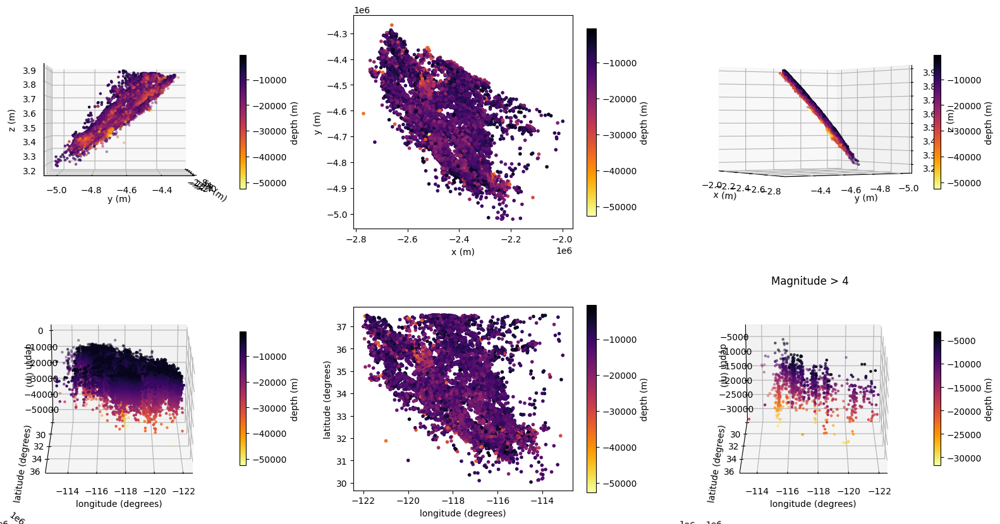

In [ ]:
fig = plt.figure(figsize=(16,9))

ax1 = fig.add_subplot(2, 3, 1, projection='3d')
scatter1 = ax1.scatter(df['x'], df['y'], df['z'], c=df['dep'], cmap='inferno_r', marker='.')
ax1.set_xlabel('x (m)')
ax1.set_ylabel('y (m)')
ax1.set_zlabel('z (m)')
ax1.view_init(0,0)
fig.colorbar(scatter1, label='depth (m)', shrink=0.5)

ax2 = fig.add_subplot(2, 3, 2)
scatter2 = ax2.scatter(df['x'], df['y'], c=df['dep'], cmap='inferno_r', marker='.')
ax2.set_xlabel('x (m)')
ax2.set_ylabel('y (m)')
ax2.set_aspect(aspect=1)
fig.colorbar(scatter2, label='depth (m)', shrink=0.7)

ax3 = fig.add_subplot(2, 3, 3, projection='3d')
scatter3 = ax3.scatter(df['x'], df['y'], df['z'], c=df['dep'], cmap='inferno_r', marker='.')
ax3.set_xlabel('x (m)')
ax3.set_ylabel('y (m)')
ax3.set_zlabel('z (m)')
ax3.view_init(0,150)
fig.colorbar(scatter3, label='depth (m)', shrink=0.5)

ax4 = fig.add_subplot(2, 3, 4, projection='3d')
scatter4 = ax4.scatter(df['lon'], df['lat'], df['dep'], c=df['dep'], cmap='inferno_r', marker='.')
ax4.set_xlabel('longitude (degrees)')
ax4.set_ylabel('latitude (degrees)')
ax4.set_zlabel('depth (m)')
ax4.view_init(20,90)
fig.colorbar(scatter4, label='depth (m)', shrink=0.5)

ax5 = fig.add_subplot(2, 3, 5)
scatter5 = ax5.scatter(df['lon'], df['lat'], c=df['dep'], cmap='inferno_r', marker='.')
ax5.set_xlabel('longitude (degrees)')
ax5.set_ylabel('latitude (degrees)')
ax5.set_aspect(aspect=1)
fig.colorbar(scatter5, label='depth (m)', shrink=0.7)

df_mag4 = df[df['Magnitude'] > 4]
ax6 = fig.add_subplot(2, 3, 6, projection='3d')
scatter6 = ax6.scatter(df_mag4['lon'], df_mag4['lat'], df_mag4['dep'], c=df_mag4['dep'], cmap='inferno_r', marker='.')
ax6.set_xlabel('longitude (degrees)')
ax6.set_ylabel('latitude (degrees)')
ax6.set_zlabel('depth (m)')
ax6.set_title('Magnitude > 4')
ax6.view_init(20,90)
fig.colorbar(scatter6, label='depth (m)', shrink=0.5)

plt.tight_layout()

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning:

divide by zero encountered in log

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning:

invalid value encountered in log



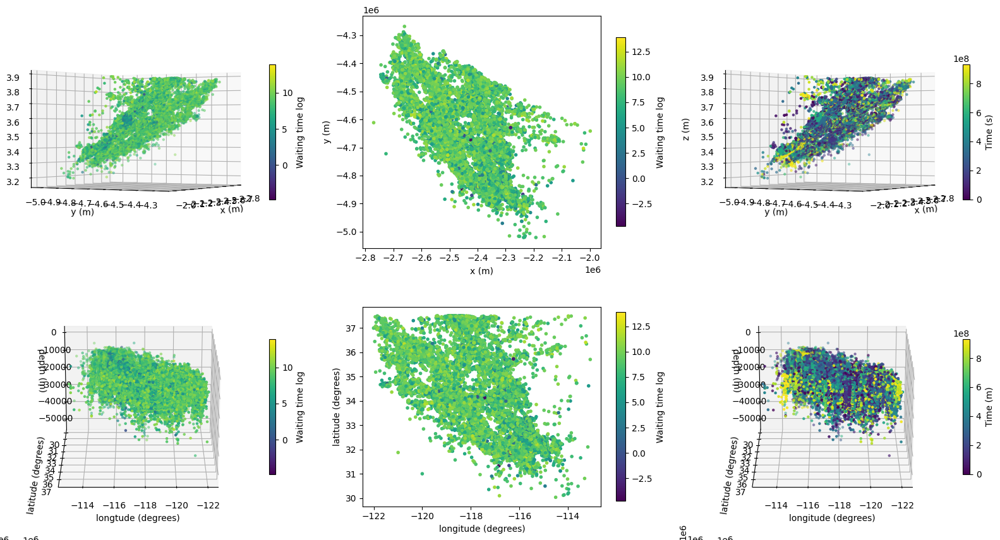

In [ ]:
fig = plt.figure(figsize=(16,9))

ax1 = fig.add_subplot(2, 3, 1, projection='3d')
scatter1 = ax1.scatter(df['x'], df['y'], df['z'], c=np.log(df['Waiting time']), cmap='viridis', marker='.')
ax1.set_xlabel('x (m)')
ax1.set_ylabel('y (m)')
ax1.set_zlabel('z (m)')
ax1.view_init(0,30)
fig.colorbar(scatter1, label='Waiting time log', shrink=0.5)

ax2 = fig.add_subplot(2, 3, 2)
scatter2 = ax2.scatter(df['x'], df['y'], c=np.log(df['Waiting time']), cmap='viridis', marker='.')
ax2.set_xlabel('x (m)')
ax2.set_ylabel('y (m)')
ax2.set_aspect(aspect=1)
fig.colorbar(scatter2, label='Waiting time log', shrink=0.7)

ax3 = fig.add_subplot(2, 3, 3, projection='3d')
scatter3 = ax3.scatter(df['x'], df['y'], df['z'], c=df['Time'], cmap='viridis', marker='.')
ax3.set_xlabel('x (m)')
ax3.set_ylabel('y (m)')
ax3.set_zlabel('z (m)')
ax3.view_init(0,30)
fig.colorbar(scatter3, label='Time (s)', shrink=0.5)

ax4 = fig.add_subplot(2, 3, 4, projection='3d')
scatter4 = ax4.scatter(df['lon'], df['lat'], df['dep'], c=np.log(df['Waiting time']), cmap='viridis', marker='.')
ax4.set_xlabel('longtude (degrees)')
ax4.set_ylabel('latitude (degrees)')
ax4.set_zlabel('depth (m)')
ax4.view_init(20,90)
fig.colorbar(scatter4, label='Waiting time log', shrink=0.5)

ax5 = fig.add_subplot(2, 3, 5)
scatter5 = ax5.scatter(df['lon'], df['lat'], c=np.log(df['Waiting time']), cmap='viridis', marker='.')
ax5.set_xlabel('longitude (degrees)')
ax5.set_ylabel('latitude (degrees)')
ax5.set_aspect(aspect=1)
fig.colorbar(scatter5, label='Waiting time log', shrink=0.7)

ax6 = fig.add_subplot(2, 3, 6, projection='3d')
scatter6 = ax6.scatter(df['lon'], df['lat'], df['dep'], c=df['Time'], cmap='viridis', marker='.')
ax6.set_xlabel('longitude (degrees)')
ax6.set_ylabel('latitude (degrees)')
ax6.set_zlabel('depth (m)')
ax6.view_init(20,90)
fig.colorbar(scatter6, label='Time (m)', shrink=0.5)

plt.tight_layout()
plt.show()

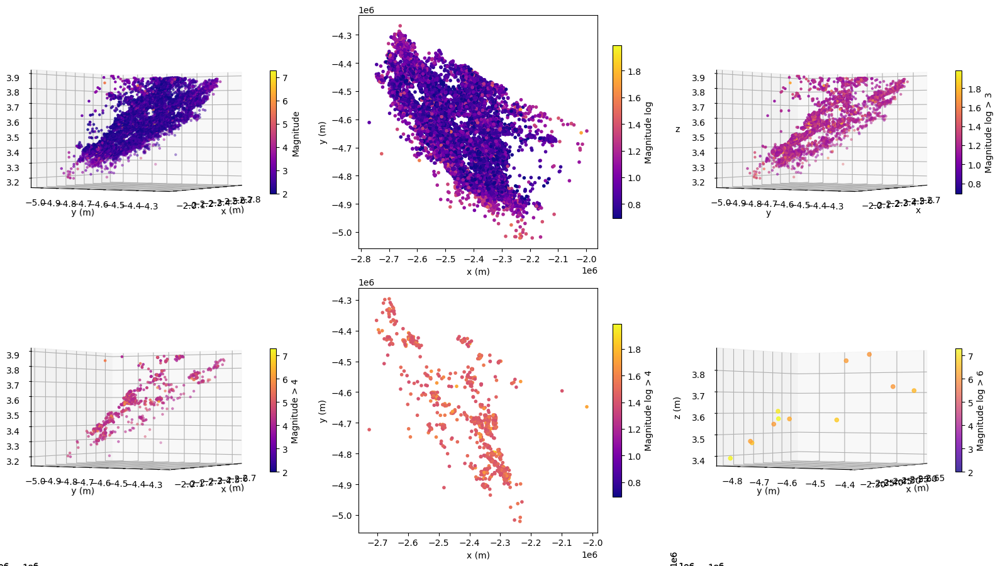

In [ ]:
fig = plt.figure(figsize=(16,9))

ax1 = fig.add_subplot(2, 3, 1, projection='3d')
scatter1 = ax1.scatter(df['x'], df['y'], df['z'], c=df['Magnitude'], cmap='plasma', marker='.', vmin=np.min(df.Magnitude), vmax=np.max(df.Magnitude))
ax1.set_xlabel('x (m)')
ax1.set_ylabel('y (m)')
ax1.set_zlabel('z (m)')
ax1.view_init(0,30)
fig.colorbar(scatter1, label='Magnitude', shrink=0.5)

ax2 = fig.add_subplot(2, 3, 2)
scatter2 = ax2.scatter(df['x'], df['y'], c=np.log(df['Magnitude']), cmap='plasma', marker='.', vmin=np.min(np.log(df.Magnitude)), vmax=np.max(np.log(df.Magnitude)))
ax2.set_xlabel('x (m)')
ax2.set_ylabel('y (m)')
ax2.set_aspect(aspect=1)
fig.colorbar(scatter2, label='Magnitude log', shrink=0.7)

df_mag3 = df[df['Magnitude'] > 3]
ax3 = fig.add_subplot(2, 3, 3, projection='3d')
scatter3 = ax3.scatter(df_mag3['x'], df_mag3['y'], df_mag3['z'], c=np.log(df_mag3['Magnitude']), cmap='plasma', marker='.', vmin=np.min(np.log(df.Magnitude)), vmax=np.max(np.log(df.Magnitude)))
ax3.set_xlabel('x')
ax3.set_ylabel('y')
ax3.set_zlabel('z')
ax3.view_init(0,30)
fig.colorbar(scatter3, label='Magnitude log > 3', shrink=0.5)

df_mag4 = df[df['Magnitude'] > 4]
ax4 = fig.add_subplot(2, 3, 4, projection='3d')
scatter4 = ax4.scatter(df_mag4['x'], df_mag4['y'], df_mag4['z'], c=df_mag4['Magnitude'], cmap='plasma', marker='.', vmin=np.min(df.Magnitude), vmax=np.max(df.Magnitude))
ax4.set_xlabel('x (m)')
ax4.set_ylabel('y (m)')
ax4.set_zlabel('z (m)')
ax4.view_init(0,30)
fig.colorbar(scatter4, label='Magnitude > 4', shrink=0.5)

ax5 = fig.add_subplot(2, 3, 5)
scatter5 = ax5.scatter(df_mag4['x'], df_mag4['y'], c=np.log(df_mag4['Magnitude']), cmap='plasma', marker='.', vmin=np.min(np.log(df.Magnitude)), vmax=np.max(np.log(df.Magnitude)))
ax5.set_xlabel('x (m)')
ax5.set_ylabel('y (m)')
ax5.set_aspect(aspect=1)
fig.colorbar(scatter5, label='Magnitude log > 4', shrink=0.7)

df_mag6 = df[df['Magnitude'] > 6]
ax6 = fig.add_subplot(2, 3, 6, projection='3d')
scatter6 = ax6.scatter(df_mag6['x'], df_mag6['y'], df_mag6['z'], c=df_mag6['Magnitude'], cmap='plasma', marker='o', alpha=0.8, vmin=np.min(df.Magnitude), vmax=np.max(df.Magnitude))
ax6.set_xlabel('x (m)')
ax6.set_ylabel('y (m)')
ax6.set_zlabel('z (m)')
ax6.view_init(0,30)
fig.colorbar(scatter6, label='Magnitude log > 6', shrink=0.5)

plt.tight_layout()
plt.show()

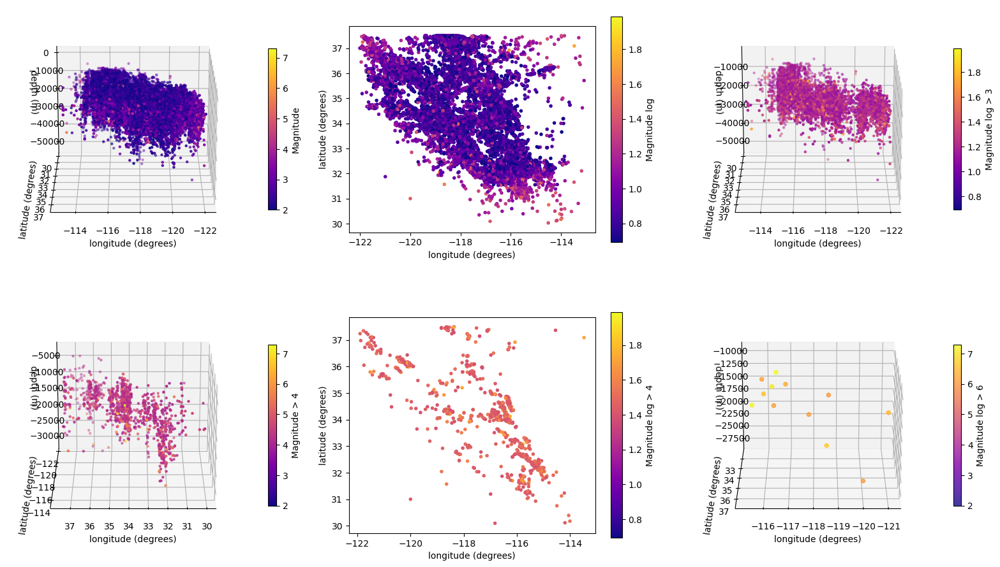

In [ ]:
fig = plt.figure(figsize=(16,10))

ax1 = fig.add_subplot(2, 3, 1, projection='3d')
scatter1 = ax1.scatter(df['lon'], df['lat'], df['dep'], c=df['Magnitude'], cmap='plasma', marker='.', vmin=np.min(df.Magnitude), vmax=np.max(df.Magnitude))
ax1.set_xlabel('longitude (degrees)')
ax1.set_ylabel('latitude (degrees)')
ax1.set_zlabel('depth (m)')
ax1.view_init(20,90)
fig.colorbar(scatter1, label='Magnitude', shrink=0.5)

ax2 = fig.add_subplot(2, 3, 2)
scatter2 = ax2.scatter(df['lon'], df['lat'], c=np.log(df['Magnitude']), cmap='plasma', marker='.', vmin=np.min(np.log(df.Magnitude)), vmax=np.max(np.log(df.Magnitude)))
ax2.set_xlabel('longitude (degrees)')
ax2.set_ylabel('latitude (degrees)')
ax2.set_aspect(aspect=1)
fig.colorbar(scatter2, label='Magnitude log', shrink=0.7)

df_mag3 = df[df['Magnitude'] > 3]
ax3 = fig.add_subplot(2, 3, 3, projection='3d')
scatter3 = ax3.scatter(df_mag3['lon'], df_mag3['lat'], df_mag3['dep'], c=np.log(df_mag3['Magnitude']), cmap='plasma', marker='.', vmin=np.min(np.log(df.Magnitude)), vmax=np.max(np.log(df.Magnitude)))
ax3.set_xlabel('longitude (degrees)')
ax3.set_ylabel('latitude (degrees)')
ax3.set_zlabel('depth (m)')
ax3.view_init(20,90)
fig.colorbar(scatter3, label='Magnitude log > 3', shrink=0.5)

df_mag4 = df[df['Magnitude'] > 4]
ax4 = fig.add_subplot(2, 3, 4, projection='3d')
scatter4 = ax4.scatter(df_mag4['lat'], df_mag4['lon'], df_mag4['dep'], c=df_mag4['Magnitude'], cmap='plasma', marker='.', vmin=np.min(df.Magnitude), vmax=np.max(df.Magnitude))
ax4.set_xlabel('longitude (degrees)')
ax4.set_ylabel('latitude (degrees)')
ax4.set_zlabel('depth (m)')
ax4.view_init(20,90)
fig.colorbar(scatter4, label='Magnitude > 4', shrink=0.5)

ax5 = fig.add_subplot(2, 3, 5)
scatter5 = ax5.scatter(df_mag4['lon'], df_mag4['lat'], c=np.log(df_mag4['Magnitude']), cmap='plasma', marker='.', vmin=np.min(np.log(df.Magnitude)), vmax=np.max(np.log(df.Magnitude)))
ax5.set_xlabel('longitude (degrees)')
ax5.set_ylabel('latitude (degrees)')
ax5.set_aspect(aspect=1)
fig.colorbar(scatter5, label='Magnitude log > 4', shrink=0.7)

df_mag6 = df[df['Magnitude'] > 6]
ax6 = fig.add_subplot(2, 3, 6, projection='3d')
scatter6 = ax6.scatter(df_mag6['lon'], df_mag6['lat'], df_mag6['dep'], c=df_mag6['Magnitude'], cmap='plasma', marker='o', alpha=0.8, vmin=np.min(df.Magnitude), vmax=np.max(df.Magnitude))
ax6.set_xlabel('longitude (degrees)')
ax6.set_ylabel('latitude (degrees)')
ax6.set_zlabel('depth (m)')
ax6.view_init(20,90)
fig.colorbar(scatter6, label='Magnitude log > 6', shrink=0.5)

plt.tight_layout()
plt.show()

### 2.1.3 Interactive and animated maps

In [ ]:
ax1 = px.scatter_mapbox(df, lat=df.lat, lon=df.lon, color=df.Magnitude, width=600, height=500, opacity=0.5, color_continuous_scale='plasma',
                        center=dict(lat=32, lon=-117), zoom=4, title='Interactive map of the South California earthquakes',
                        mapbox_style='open-street-map')
ax1.show()

ax2 = px.scatter_mapbox(df, lat=df.lat, lon=df.lon, color=df.dep, width=600, height=500, opacity=0.5, color_continuous_scale='inferno_r',
                        center=dict(lat=32, lon=-117), zoom=4, title='Interactive map of the South California earthquakes',
                        mapbox_style='open-street-map')
ax2.show()

In [ ]:
df['Animation_frame'] = np.round(200*(df['Time']/df['Time'].max()))

In [ ]:
ax1 = px.scatter_mapbox(df, lat=df.lat, lon=df.lon, color=df.Magnitude, width=600, height=500, opacity=1, color_continuous_scale='plasma', range_color=[df.Magnitude.min(), df.Magnitude.max()],
                        center=dict(lat=33.5, lon=-117), zoom=4, title='Interactive map of the South California earthquakes', animation_frame=df.Animation_frame,
                        mapbox_style='open-street-map')
ax1.show()

ax2 = px.scatter_mapbox(df, lat=df.lat, lon=df.lon, color=df.dep, width=600, height=500, opacity=1, color_continuous_scale='inferno_r', range_color=[df.dep.min(), df.dep.max()],
                        center=dict(lat=33.5, lon=-117), zoom=4, title='Interactive map of the South California earthquakes', animation_frame=df.Animation_frame,
                        mapbox_style='open-street-map')
ax2.show()

### 2.1.4 Distribution plots

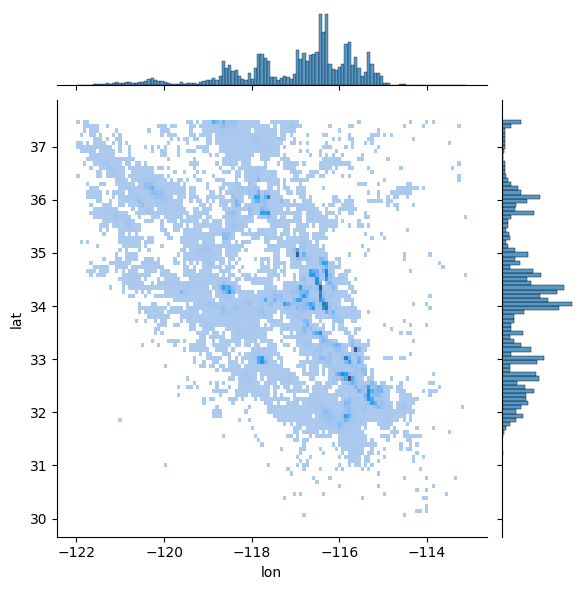

In [ ]:
sns.jointplot(df, x=df.lon, y=df.lat, kind='hist')
plt.show()

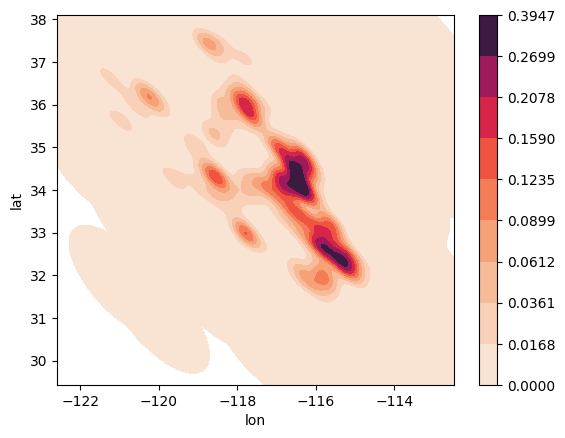

In [ ]:
sns.kdeplot(df, x=df.lon, y=df.lat, fill=True, thresh=0, levels=10, cmap='rocket_r', cbar=True, label='Density')
plt.show()

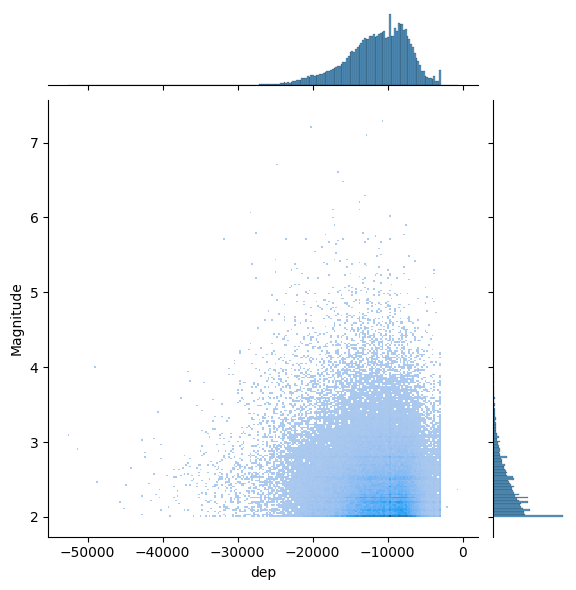

In [ ]:
sns.jointplot(df, x=df.dep, y=df.Magnitude, kind='hist')
plt.show()

### 2.1.5 Time analysis

We analyzed the event occourrence in time, looking for relevant patterns in the available data. We aimed at extrapolating a law on the frequency spectrum of time distributions, but the Fast Fourier Transform didn't yield any relevant results. A reason of this could be that the data acquisition lasted about 30 years, which is quite small for the geological timescales.

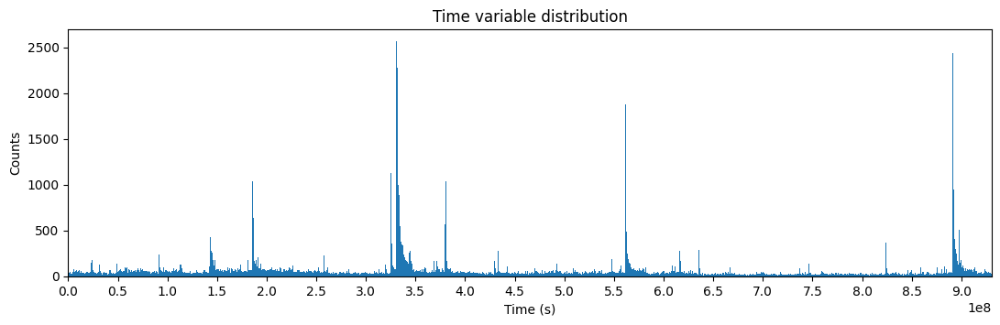

In [ ]:
fig = plt.figure(figsize=(13,3.5))
ax = fig.add_subplot(1,1,1)

n, bins, _ = ax.hist(df.Time, bins=5*int(np.sqrt(np.shape(df)[0])))

ax.set_xticks([i for i in 0.5e8*np.arange(20)])
ax.set_xlim(0, np.max(df.Time))
ax.set_title('Time variable distribution')
ax.set_xlabel('Time (s)')
ax.set_ylabel('Counts')
plt.show()

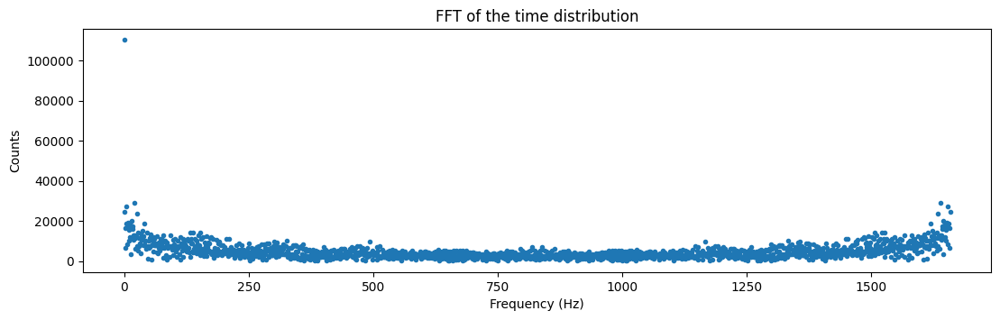

In [ ]:
centroids = bins[:-1] - bins[1:]
event_time_dist = np.concatenate((centroids.reshape(np.shape(centroids)[0], 1), n.reshape(np.shape(n)[0], 1)), axis=1)

spectrum = abs(fft(n))

fig = plt.figure(figsize=(13,3.5))
ax = fig.add_subplot(1,1,1)
ax.scatter(np.arange(1660), spectrum, marker='.')

np.shape(spectrum)

ax.set_title('FFT of the time distribution')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Counts')
plt.show()

As for the waiting time distribution, it can be noted that it follows a power law. This topic will be further developed in the following Section 3.

Text(0.5, 1.0, 'Power law waiting time histogram')

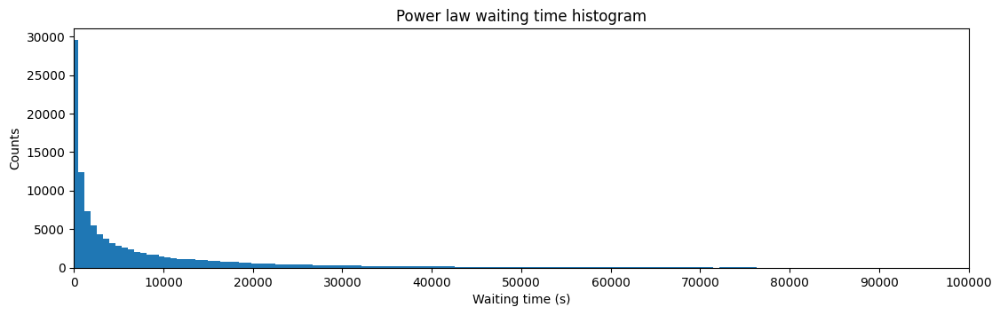

In [ ]:
fig = plt.figure(figsize=(13,3.5))
ax = fig.add_subplot(1,1,1)

n, bins, _ = ax.hist(df['Waiting time'], bins=5*int(np.sqrt(np.shape(df)[0])))

ax.set_xticks([i for i in 10000*np.arange(11)])
ax.set_xlim(0, 1e5)
ax.set_xlabel('Waiting time (s)')
ax.set_ylabel('Counts')
ax.set_title('Power law waiting time histogram')

plt.show()

## 2.2 Principal Component Analysis

We will now carry out the PCA analysis, in order to reduce the dimensionality of the dataset by removing the less representative variable. We expect the most relevant PC to be in the direction of the tectonic fault motion.

First of all, let's construct the covariance matrix: it shows the correlation between the variables of the set. In particular, in our analysis we take into account the coordinates of the points (x, y and z).

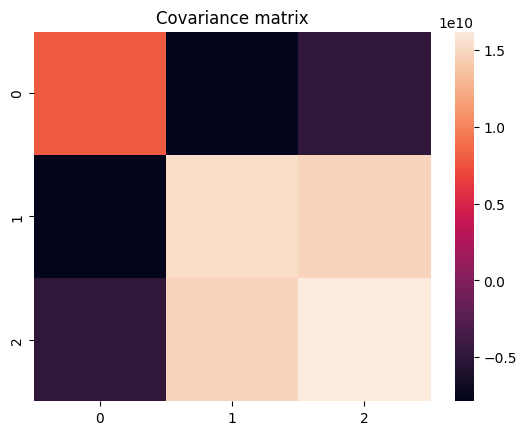

In [ ]:
PCA_array = np.array(df)[:, 4:7]

covariance_matrix = np.cov(PCA_array.T)
sns.heatmap(covariance_matrix)
plt.title('Covariance matrix')
plt.show()

In [ ]:
l, V = la.eig(covariance_matrix)

print('----------------- Eigenvalues -----------------\t \n ', l/covariance_matrix.trace())
print('----------------- Eigenvectors -----------------\t \n', V)

----------------- Eigenvalues -----------------	 
  [8.52163578e-01 1.47129636e-01 7.06786387e-04]
----------------- Eigenvectors -----------------	 
 [[-0.3294337   0.85523831 -0.40005108]
 [ 0.67429929 -0.08347451 -0.73372507]
 [ 0.66090386  0.51146792  0.54918727]]


In [ ]:
i = l.argsort()[::-1]  # reordering from the smallest to the largest eigenvalue
V = V[:, i]

# Normalizing the eigenvalues
normalized_l = l / np.sum(l)
somma = np.sum(l)
frac_x1, frac_x2, frac_x3 = l[0]/somma * 100 , l[1]/somma * 100 , l[2]/somma * 100

print('------------ Percentage contribution for different eigenvalues: ------------')
print("\n l1: %.2f" % frac_x1, '% \n', "l2: %.2f" % frac_x2, '% \n', "l3: %.2f" % frac_x3, '%')
print(frac_x1 + frac_x2 + frac_x3)
print(normalized_l)

------------ Percentage contribution for different eigenvalues: ------------

 l1: 85.22 % 
 l2: 14.71 % 
 l3: 0.07 %
100.00000000000001
[8.52163578e-01 1.47129636e-01 7.06786387e-04]


As can be seen, the contribution given by the third coordinate is the smallest, so it can be removed by applying the PCA.
In the subplot we show the dimensions before and after the PCA with the corresponding eigenvectors.

The transformed covariance matrix presents only two elements along the first principal diagonal, while the third dimension is removed after applying PCA.

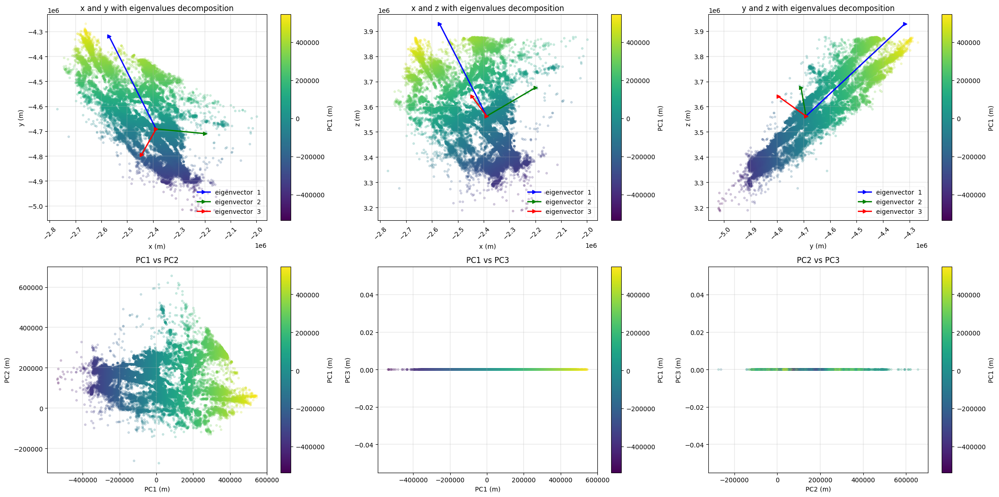

In [ ]:
x1, x2, x3 = PCA_array[:, 0], PCA_array[:, 1], PCA_array[:, 2]
# Setting the starting coordinates for the eigenvector plotting
mean_x1 = np.mean(x1)
mean_x2 = np.mean(x2)
mean_x3 = np.mean(x3)

Xp = np.dot(V[:,:2].T, [x1, x2, x3])
Xp = np.vstack((Xp, np.zeros(Xp.shape[1])))


plt.figure(figsize=(22,16))

### PLOT 1 ###

plt.subplot(331)

norm = plt.Normalize(Xp[0,:].min(), Xp[0,:].max())
cmap = plt.get_cmap('viridis')
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.scatter(x1, x2, c = Xp[0,:], alpha = 0.2, marker = '.', cmap = cmap, norm = norm)
plt.xticks(rotation=45)
cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('PC1 (m)')

counter = 1
for li, vi, si, ci in zip(normalized_l, V.T, scale_factor, colors):
    plt.plot([mean_x1, si*li*vi[0]+mean_x1], [mean_x2, si*li*vi[1]+mean_x2], ci, lw = 2, marker='>', label = 'eigenvector  ' + str(counter))
    counter += 1

plt.title('x and y with eigenvalues decomposition')
plt.xlabel('x (m)')
plt.ylabel('y (m)')
plt.grid(True, linewidth=0.3)
legend = plt.legend(loc='lower right')
legend.get_frame().set_alpha(0.2)

### PLOT 2 ###

plt.subplot(332)

norm = plt.Normalize(Xp[0,:].min(), Xp[0,:].max())
cmap = plt.get_cmap('viridis')
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.scatter(x1, x3, c = Xp[0,:], alpha = 0.2, marker = '.', cmap = cmap, norm = norm)
plt.xticks(rotation=45)
cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('PC1 (m)')

counter = 1
for li, vi, si, ci in zip(normalized_l, V.T, scale_factor, colors):
    plt.plot([mean_x1, si*li*vi[0]+mean_x1], [mean_x3, si*li*vi[2]+mean_x3], ci, lw = 2, marker='>', label = 'eigenvector  ' + str(counter)) #proiezione degli autovettori nel piano (x, z)
    counter += 1

plt.title('x and z with eigenvalues decomposition')
plt.xlabel('x (m)')
plt.ylabel('z (m)')
plt.grid(True, linewidth=0.3)
legend = plt.legend(loc='lower right')
legend.get_frame().set_alpha(0.2)

### PLOT 3 ###

plt.subplot(333)

norm = plt.Normalize(Xp[0,:].min(), Xp[0,:].max())
cmap = plt.get_cmap('viridis')
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.scatter(x2, x3, c = Xp[0,:], alpha = 0.2, marker = '.', cmap = cmap, norm = norm)
plt.xticks(rotation=45)
cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('PC1 (m)')

counter = 1
for li, vi, si, ci in zip(normalized_l, V.T, scale_factor, colors):
    plt.plot([mean_x2, si*li*vi[1]+mean_x2], [mean_x3, si*li*vi[2]+mean_x3], ci, lw = 2, marker='>', label = 'eigenvector  ' + str(counter)) #proiezione degli autovettori nel piano (y, z)
    counter += 1

plt.title('y and z with eigenvalues decomposition')
plt.xlabel('y (m)')
plt.ylabel('z (m)')
plt.grid(True, linewidth=0.3)
legend = plt.legend(loc='lower right')
legend.get_frame().set_alpha(0.2)

### PLOT 4 ###

plt.subplot(334)

norm = plt.Normalize(Xp[0,:].min(), Xp[0,:].max())
cmap = plt.get_cmap('viridis')
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.scatter(Xp[0,:], Xp[1,:], alpha=0.2, marker = '.', c = Xp[0,:], cmap = cmap, norm = norm)
cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('PC1 (m)')

plt.title('PC1 vs PC2')
plt.xlabel('PC1 (m)')
plt.ylabel('PC2 (m)')
plt.grid(True, linewidth=0.3)

### PLOT 5 ###

plt.subplot(335)

norm = plt.Normalize(Xp[0,:].min(), Xp[0,:].max())
cmap = plt.get_cmap('viridis')
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.scatter(Xp[0,:], Xp[2,:], alpha = 0.2, marker = '.', c = Xp[0,:], cmap = cmap, norm = norm)

cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('PC1 (m)')
plt.title('PC1 vs PC3')
plt.xlabel('PC1 (m)')
plt.ylabel('PC3 (m)')
plt.grid(True, linewidth=0.3)

### PLOT 6 ###

plt.subplot(336)

norm = plt.Normalize(Xp[0,:].min(), Xp[0,:].max())
cmap = plt.get_cmap('viridis')
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.scatter(Xp[1,:], Xp[2,:], alpha = 0.2, marker = '.', c = Xp[0,:], cmap = cmap, norm = norm)
cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('PC1 (m)')
plt.title('PC2 vs PC3')
plt.xlabel('PC2 (m)')
plt.ylabel('PC3 (m)')
plt.grid(True, linewidth=0.3)

scale_factor =[650000, 1500000, 200000000]
colors = ['blue', 'green', 'red']

plt.tight_layout()
plt.show()

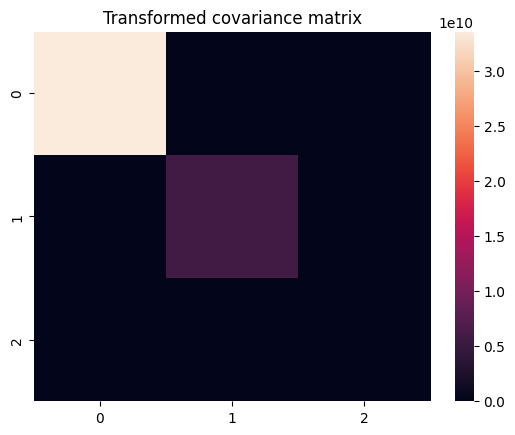

In [ ]:
n_obs,  n_col = Xp.shape
Xp_2D = np.reshape(Xp, (n_obs,  n_col))
cov = np.cov(Xp_2D)
sns.heatmap(cov)
plt.title('Transformed covariance matrix')
plt.show()

# 3. Distribution $P_m(t)$ of the Waiting Times

## 3.1 Functions definition

The `log_plot` function sets up all the parameters we need to plot the histogram in log-log scale:

* To select the number of bins, we use used the Knuth binning rule (*$``\text{Optimal Data-Based Binning for Histograms}"$, Kevin H. Knuth, 2013*).

* We generate an equally logarithmically spaced set of points using `np.logspace()`, specifying the number of bins we calculated earlier.

* After evaluating bin centers and bin widths we normalize the histogram in order to give a statistical meaning to the distribution.

* We remove the empty bins in order for us to be able to evaluate the errors propagating the Poisson error of the unnormalized histogram.

* The function returns the bin centers, the counts per bin and the errors (all on logarithmic scale).

In [ ]:
def log_plot(feature):

    #Excluding zeros
    feature = feature[feature != 0]

    #Discard consecutive elements of the feature to avoid correlations
    feature = feature[::2]

    #Bin edges (in logarithmic scale)
    #n_bins = max([np.histogram_bin_edges(np.log10(feature), bins = 'scott').shape[0] - 1, 10])
    _, bin_edges = knuth(np.log10(feature), return_bins = True)

    x = np.logspace(np.log10(feature.min()), np.log10(feature.max()), base = 10, num = bin_edges.shape[0] - 1)

    #Histogram data
    hist = np.histogram(feature, bins = x)
    bin_centers = (hist[1][1:] + hist[1][:-1]) / 2
    bin_widths = hist[1][1:] - hist[1][:-1]

    #Normalization of the histogram
    norm = np.sum(hist[0])
    counts_normalized = hist[0] / (bin_widths * norm)

    #Clean of empty bins
    mask = (counts_normalized > 0)
    counts_normalized = counts_normalized[mask]
    bin_centers = bin_centers[mask]

    bins = np.log10(bin_centers)
    counts = np.log10(counts_normalized)
    errors = np.log10(np.e) / np.sqrt(hist[0][mask])

    return bins, counts, errors

As discussed later, we use the `cut_tails` function to properly select the linearly distributed points (in log-log scale):

* For the left side, we first arbitrarily drop all data points with a given threshold.

* Then, for both sides, we recursively compare the pearson coefficient with the one we would get by removing the extreme point: if the new value is better than the previous one we reject that point, otherwise we stop the algorithm.

* The function returns bin centers, number of counts per bin, errors and the pearson coefficients list.

In [ ]:
def cut_tails(b, c, e, threshold):

    c = c[b >= threshold]
    e = e[b >= threshold]
    b = b[b >= threshold]

    pearson = [0]

    while True:
        new_p = np.corrcoef(b[:-1], y = c[:-1])[0,1]
        if(new_p > pearson[-1] or len(b) <= 9):
            break
        b = b[:-1]
        c = c[:-1]
        e = e[:-1]
        pearson.append(new_p)

    while True:
        new_p = np.corrcoef(b[1:], y = c[1:])[0,1]
        if(new_p > pearson[-1] or len(b) <= 9):
            break
        b = b[1:]
        c = c[1:]
        e = e[1:]
        pearson.append(new_p)

    return b, c, e, pearson

The `statistic_plots` function allows us to perform a linear regression on the given feature and to evaluate the $\chi^2$.

In [ ]:
f_lin = lambda x, m, q: m*x+q

def statistic_plots(bins, counts, magnitudes, errors, feature, spec = '', show_plots=True):
    fit_res = []

    if(show_plots):
        fig, ax = plt.subplots(2, len(magnitudes), figsize = (14, 6))

    for i, (x, y, m, e) in enumerate(zip(bins, counts, magnitudes, errors)):

        #Linear regression
        (slope, intercept), pcov = curve_fit(f_lin, x, y, sigma=e, absolute_sigma=True)

        #Residuals
        residuals = y - (slope*x+intercept)
        chisquare = np.sum((residuals/e)**2)
        dof = x.shape[0]-2 #degrees of freedom of the chisquare
        fit_res.append((slope, intercept, pcov, chisquare, dof))

        #Plot
        if(show_plots):
            x_axis = np.linspace(x.min(), x.max(), 100)
            ax[0,i].scatter(x, y, label="Data points")
            ax[0,i].plot(x_axis, (slope * x_axis) + intercept, color = 'darkred', label = 'Fit')
            ax[0,i].set_ylabel(f"$\log(P_{m}({feature})$)")
            ax[0,i].set_xlabel(f"$\log({feature})$")
            ax[0,i].grid()

            #Residual plot
            ax[1,i].errorbar(x, residuals, yerr = e, fmt = 'o', capsize = 2.5, label="Residual")
            ax[1,i].hlines(0,x.min(), x.max(), color='darkred', label = 'Fit')
            ax[1,i].grid()

    if(show_plots):
        ax[0,-1].legend()
        ax[1,-1].legend()
        fig.suptitle('Linear regressions and residuals' + spec, fontsize = 18)
        plt.tight_layout()
        plt.show()

    return fit_res

## 3.2 Time-dependent Analyses

As features we need waiting times, which we can get by applying the `diff()` function to the 'Time' column of the dataframe starting from the second row.

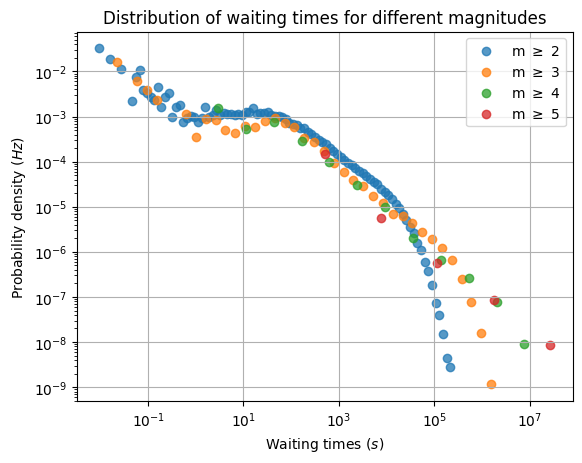

In [ ]:
#Inizializing lists
magnitudes = [2, 3, 4, 5]
bins = []
counts = []
errors = []

for i, m in enumerate(magnitudes):

    #Array of waiting times
    wt = np.array(df[df['Magnitude'] >= m][['Time']].sort_values('Time').diff())[1:]

    #Prepare data for plot
    b, c, e = log_plot(wt)
    bins.append(b)
    counts.append(c)
    errors.append(e)

    #Plot
    plt.scatter(10 ** b, 10 ** c, alpha = 0.75, label = f"m $\geq$ {m}")
    plt.xscale('log', base = 10)
    plt.yscale('log', base = 10)

plt.xlabel('Waiting times ($s$)')
plt.ylabel('Probability density ($Hz$)')
plt.title('Distribution of waiting times for different magnitudes')
plt.legend()
plt.grid()
plt.show()

We expect a power-law distribution of the waiting times for all magnitudes of the type

$$P_m(wt)=kwt^A$$

Performing a logarithmic transformation on the data that gives

$$\log_{10}P_m(wt)=A\log_{10}(wt)+B$$

i.e. a linear distribution.

So, in order to prove this, we will apply a linear regression and verify if this is the law followed by data.

Now we can apply the `cut_tails()` function in order to select only the linear regime of the distributions.

In [ ]:
pearson_list = []
last_cut_list = []

counts_cut = counts.copy()
errors_cut = errors.copy()
bins_cut = bins.copy()

for i, m in enumerate(magnitudes):

    bins_cut[i], counts_cut[i], errors_cut[i], pearson = cut_tails(bins[i], counts[i], errors[i], threshold = 2)
    pearson_list.append(pearson[-1])
    last_cut_list.append(bins_cut[i][-1])

Finally, we perform the linear regression and visualize both the fit and the residuals.

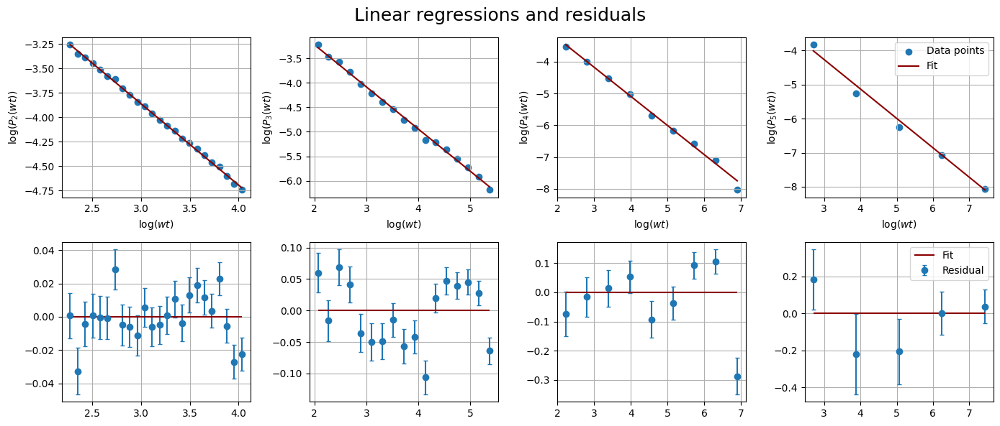

In [ ]:
fit_res = statistic_plots(bins_cut, counts_cut, magnitudes, errors_cut, 'wt')

We display the results of the linear fit.

In [ ]:
slopes = []
intercepts = []
sigmas_slope = []
sigmas_intercept = []

for res, m, p in zip(fit_res, magnitudes, pearson_list):
    slope, intercept, pcov, chisquare , dof = res
    confidence_level = (1.- chi2.cdf(chisquare, dof))*100

    slopes.append(slope)
    intercepts.append(intercept)

    sigma_slope, sigma_intercept = np.sqrt(np.diag(pcov))

    sigmas_slope.append(sigma_slope)
    sigmas_intercept.append(sigma_intercept)

    print(f"------ Earthquakes with magnitude m ≥ {m}  ------")
    print(f"Slope: {slope:.3f} ± {sigma_slope:.3f}")
    print(f"Intercept: {intercept:.3f} ± {sigma_intercept:.3f}")
    print(f"Pearson coefficient: {p:.2f}")
    print(f"Degrees of freedom: {dof}")
    #print(f"Chi2: {chisquare:.2f}")
    #print(f"Hypotesis accepted with confidence level {confidence_level:.1f}%")
    print()

------ Earthquakes with magnitude m ≥ 2  ------
Slope: -0.831 ± 0.004
Intercept: -1.369 ± 0.015
Pearson coefficient: -1.00
Degrees of freedom: 22

------ Earthquakes with magnitude m ≥ 3  ------
Slope: -0.860 ± 0.006
Intercept: -1.505 ± 0.025
Pearson coefficient: -1.00
Degrees of freedom: 15

------ Earthquakes with magnitude m ≥ 4  ------
Slope: -0.917 ± 0.013
Intercept: -1.428 ± 0.069
Pearson coefficient: 0.00
Degrees of freedom: 7

------ Earthquakes with magnitude m ≥ 5  ------
Slope: -0.864 ± 0.036
Intercept: -1.672 ± 0.223
Pearson coefficient: 0.00
Degrees of freedom: 3



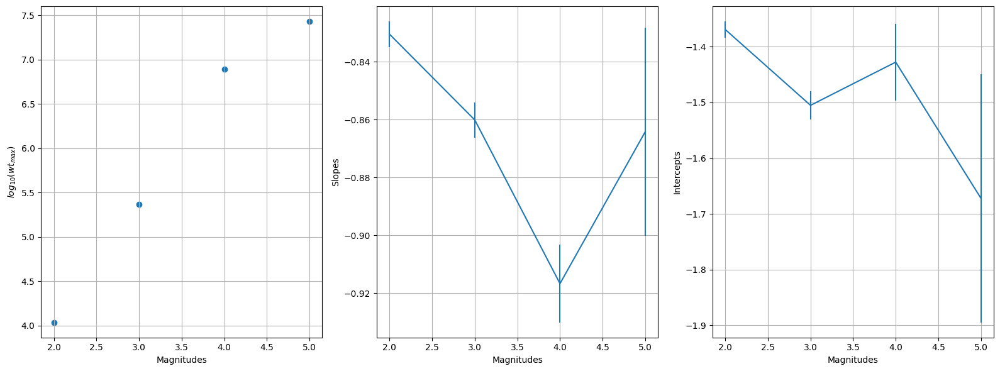

In [ ]:
fig, ax = plt.subplots(1, 3, figsize = (16,6))

ax[0].scatter(magnitudes, last_cut_list)
ax[0].set_xlabel('Magnitudes')
ax[0].set_ylabel('$log_{10}(wt_{max})$')
ax[0].grid()

ax[1].errorbar(magnitudes, slopes, sigmas_slope)
ax[1].set_xlabel('Magnitudes')
ax[1].set_ylabel('Slopes')
ax[1].grid()

ax[2].errorbar(magnitudes, intercepts, sigmas_intercept)
ax[2].set_xlabel('Magnitudes')
ax[2].set_ylabel('Intercepts')
ax[2].grid()

plt.tight_layout()
plt.show()

We notice two important things:

* Slopes and intercepts of linear regressions seem to be close to the same value: $-1$ for the former and $-1.5$ for the latter; we will later investigate whether these parameters are universal constants or they depend on the choice of magnitudes and maximum distances.

* Let's define $wt_{max}$ as the maximum value of waiting times in linear regime. We can see that the distribution decreases significantly after this threshold. Also, $wt_{max}$ increases with the growth of the magnitude.

In order to collapse each distribution into a single trend line, we produce a new plot of the probability density function normalized with respect to the regressions we obtained earlier versus the waiting times normalized by $wt_{max}$.

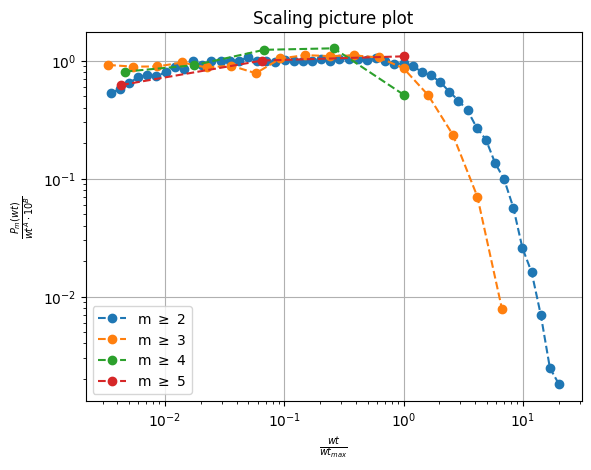

In [ ]:
for b, c, e, m, last_cut, slope, intercept in zip(bins, counts, errors, magnitudes, last_cut_list, slopes, intercepts):

    c = c[b >= last_cut-2.5]
    e = e[b >= last_cut-2.5]
    b = b[b >= last_cut-2.5]

    plt.plot((10 ** b) / (10 ** last_cut), (10 ** c) / (10 ** (slope * b + intercept)), alpha = 1, linestyle = '--', marker = 'o', label = f"m $\geq$ {m}")
    plt.xscale('log', base = 10)
    plt.yscale('log', base = 10)

plt.xlabel("$\\frac{wt}{wt_{max}}$")
plt.ylabel("$\\frac{P_m(wt)}{wt^A\cdot10^B}$")
plt.title("Scaling picture plot")
plt.grid()
plt.legend()
plt.show()

# 4. Distribution $P_m(r)$ of the Distances

We repeat what we did in the previous point for the distances between two consecutive measurement.

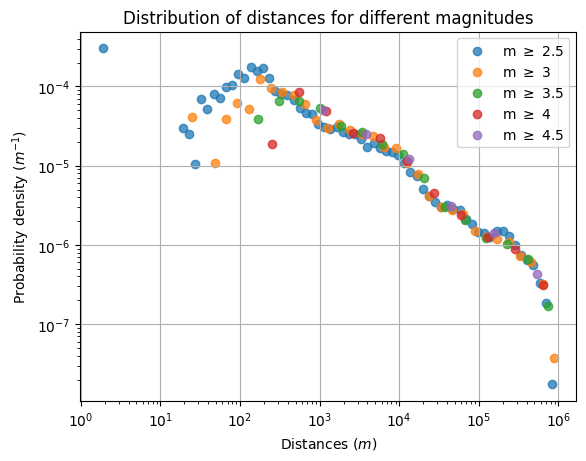

In [ ]:
magnitudes = [2.5, 3, 3.5, 4, 4.5]

bins   = []
counts = []
errors = []

for i, m in enumerate(magnitudes):
      #Array of siatcnes
      df2 = df[df['Magnitude'] >= m].sort_values('Time')[['x', 'y', 'z']]
      coordinates = df2.to_numpy()
      d = np.linalg.norm(np.diff(coordinates, axis = 0), axis = 1)

      #Prepare data for plot
      b, c, e = log_plot(d)
      bins.append(b)
      counts.append(c)
      errors.append(e)

      #Plot
      plt.scatter(10 ** b, 10 ** c, alpha = 0.75, label = f"m $\geq$ {m}")
      plt.xscale('log', base = 10)
      plt.yscale('log', base = 10)

plt.xlabel('Distances ($m$)')
plt.ylabel('Probability density ($m^{-1}$)')
plt.title('Distribution of distances for different magnitudes')
plt.legend()
plt.grid()
plt.show()

In [ ]:
pearson_list = []
last_cut_list = []

counts_cut = counts[:]
errors_cut = errors[:]
bins_cut = bins[:]

for i, m in enumerate(magnitudes):

    bins_cut[i], counts_cut[i], errors_cut[i], pearson = cut_tails(bins[i], counts[i], errors[i], threshold = 2)
    pearson_list.append(pearson[-1])
    last_cut_list.append(bins_cut[i][-1])

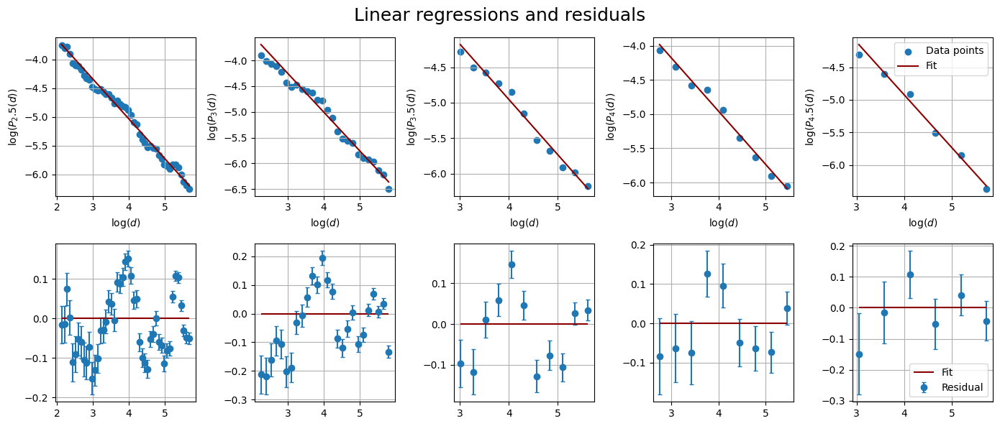

In [ ]:
fit_res = statistic_plots(bins_cut, counts_cut, magnitudes, errors_cut, 'd')

We display the results of the linear fit.

In [ ]:
slopes = []
intercepts = []
sigmas_slope = []
sigmas_intercept = []

for res, m, p in zip(fit_res, magnitudes, pearson_list):
    slope, intercept, pcov, chisquare , dof = res
    confidence_level = (1.- chi2.cdf(chisquare, dof))*100

    slopes.append(slope)
    intercepts.append(intercept)

    sigma_slope, sigma_intercept = np.sqrt(np.diag(pcov))

    sigmas_slope.append(sigma_slope)
    sigmas_intercept.append(sigma_intercept)

    print(f"------ Earthquakes with magnitude m ≥ {m}  ------")
    print(f"Slope: {slope:.3f} ± {sigma_slope:.3f}")
    print(f"Intercept: {intercept:.3f} ± {sigma_intercept:.3f}")
    print(f"Pearson coefficient: {p:.2f}")
    print(f"Degrees of freedom: {dof}")
    #print(f"Chi2: {chisquare:.2f}")
    #print(f"Hypotesis accepted with confidence level {confidence_level:.1f}%")
    print()

------ Earthquakes with magnitude m ≥ 2.5  ------
Slope: -0.692 ± 0.004
Intercept: -2.262 ± 0.017
Pearson coefficient: -0.99
Degrees of freedom: 45

------ Earthquakes with magnitude m ≥ 3  ------
Slope: -0.752 ± 0.006
Intercept: -1.999 ± 0.030
Pearson coefficient: -0.99
Degrees of freedom: 24

------ Earthquakes with magnitude m ≥ 3.5  ------
Slope: -0.781 ± 0.014
Intercept: -1.832 ± 0.065
Pearson coefficient: -0.99
Degrees of freedom: 9

------ Earthquakes with magnitude m ≥ 4  ------
Slope: -0.776 ± 0.024
Intercept: -1.854 ± 0.111
Pearson coefficient: -0.99
Degrees of freedom: 7

------ Earthquakes with magnitude m ≥ 4.5  ------
Slope: -0.809 ± 0.039
Intercept: -1.689 ± 0.189
Pearson coefficient: 0.00
Degrees of freedom: 4



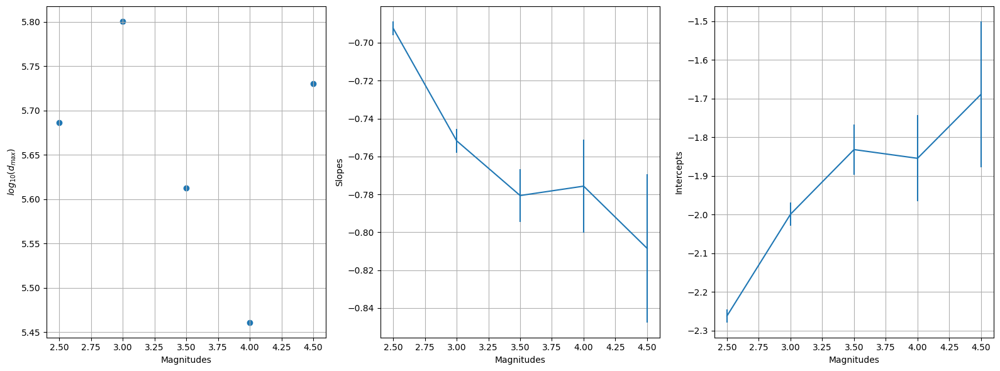

In [ ]:
fig, ax = plt.subplots(1, 3, figsize = (16,6))

ax[0].scatter(magnitudes, last_cut_list)
ax[0].set_xlabel('Magnitudes')
ax[0].set_ylabel('$log_{10}(d_{max})$')
ax[0].grid()

ax[1].errorbar(magnitudes, slopes, sigmas_slope)
ax[1].set_xlabel('Magnitudes')
ax[1].set_ylabel('Slopes')
ax[1].grid()

ax[2].errorbar(magnitudes, intercepts, sigmas_intercept)
ax[2].set_xlabel('Magnitudes')
ax[2].set_ylabel('Intercepts')
ax[2].grid()

plt.tight_layout()
plt.show()

In contrast to waiting times, it seems there isn't a clear correlation between magnitudes and $d_{max}$, so we will recreate the scaling picture plot without normalizing the x-axis.

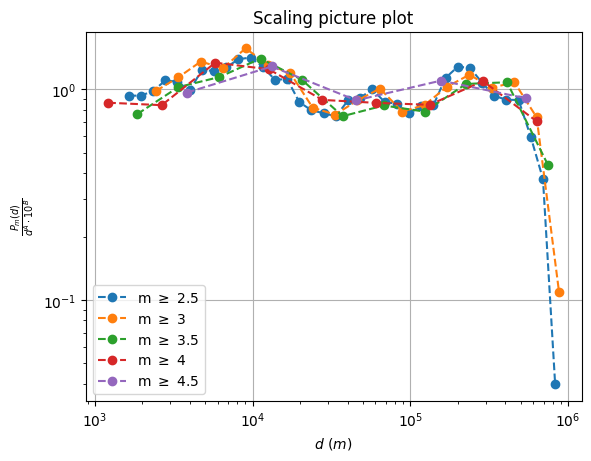

In [ ]:
for b, c, e, m, last_cut, slope, intercept in zip(bins, counts, errors, magnitudes, last_cut_list, slopes, intercepts):

    c = c[b >= last_cut-2.5]
    e = e[b >= last_cut-2.5]
    b = b[b >= last_cut-2.5]

    plt.plot((10 ** b), (10 ** c) / (10 ** (slope * b + intercept)), alpha = 1, linestyle = '--', marker = 'o', label = f"m $\geq$ {m}")
    plt.xscale('log', base = 10)
    plt.yscale('log', base = 10)

plt.xlabel("$d \ (m)$")
plt.ylabel("$\\frac{P_m(d)}{d^A\cdot10^B}$")
plt.title("Scaling picture plot")
plt.grid()
plt.legend()
plt.show()

# 5. Distribution $P_{m,R}(t)$ of Waiting Times for events at Distance $r<R$

We construct a function - called `get_Pmr()` - which, for a given value of magnitude $m$ and relative distance $R$, selects the events having magnitude $\geqslant m$ and relative distance $\leqslant R$; finally, it computes the waiting times.

In [ ]:
def get_Pmr(df, m, R):

    dfm = df[df['Magnitude']>= m].sort_values('Time')[['Time', 'x', 'y', 'z']]

    #Evaluate the distance between one event and the next one
    coordinates = dfm.to_numpy()
    d = np.linalg.norm(np.diff(coordinates, axis = 0), axis = 1)
    d = np.insert(d, 0, 0)

    dfm['Rel_distance'] = d
    dfmr = dfm[dfm['Rel_distance'] <= R].sort_values('Time') #Select by distance

    wt = np.array(dfmr['Time'].diff())[1:]

    return dfmr, d, wt

Now we can plot the results using two nested cycles: with the outer one we select the magnitude and with the inner one the relative distance.

In contrast to the previous calculations we excluded the highest magnitude $m=5$ because the plot resulted into being too unpopulated.

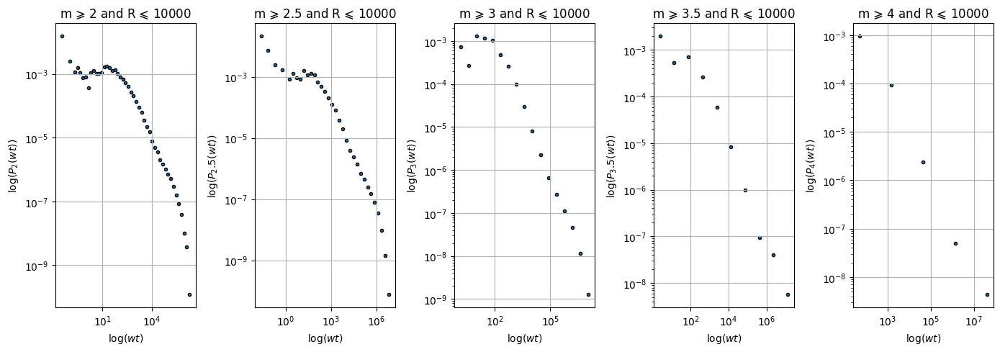

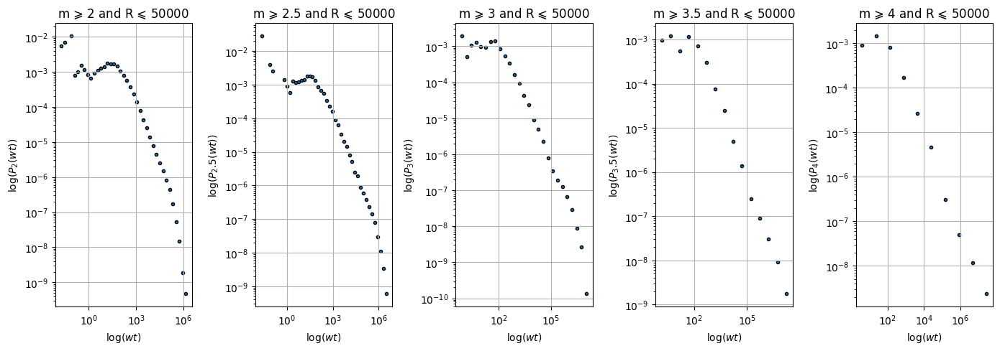

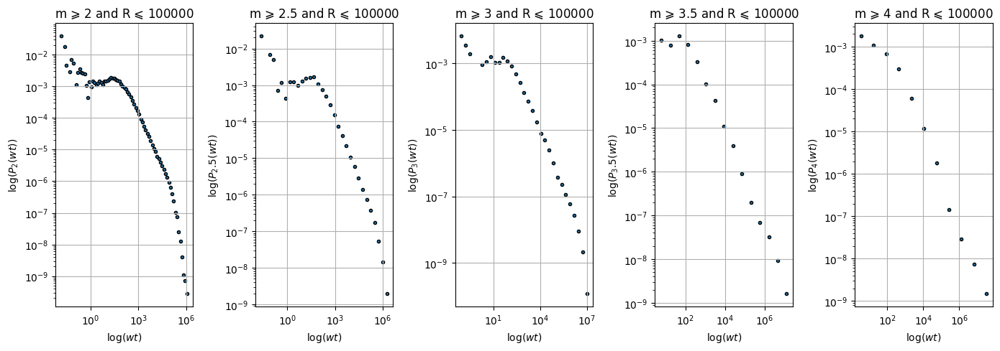

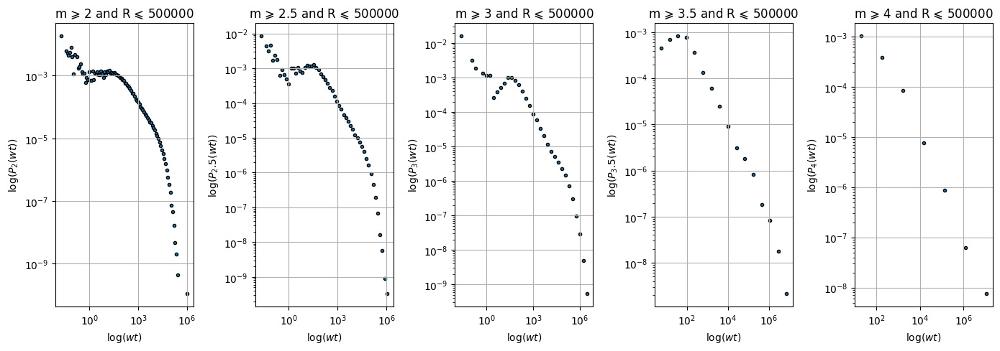

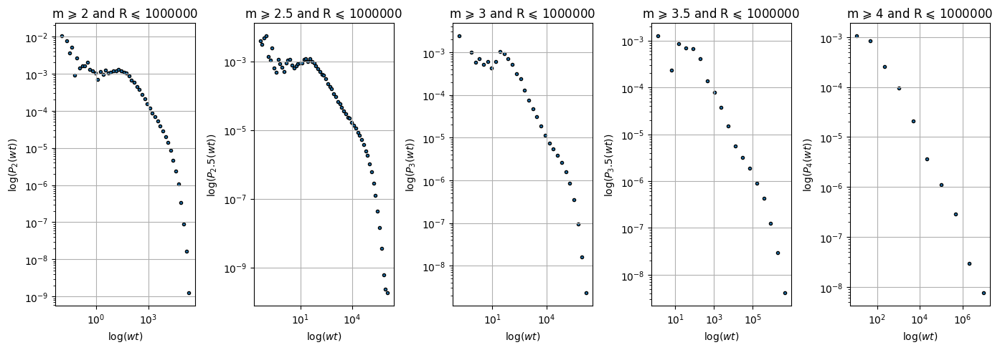

In [ ]:
magnitudes = [2, 2.5, 3, 3.5, 4]
Radii = [1e4, 5e4, 1e5, 5e5, 1e6]

bins   = [[] for _ in range(len(Radii))]
counts = [[] for _ in range(len(Radii))]
errors = [[] for _ in range(len(Radii))]

for j, radius in enumerate(Radii):
    index = 0
    fig, ax = plt.subplots(1, len(magnitudes), figsize = (14,5))

    for i, m in enumerate(magnitudes):
        dfmr, d, wt = get_Pmr(df, m, radius)

        b, c, e = log_plot(wt)
        bins[j].append(b)
        counts[j].append(c)
        errors[j].append(e)

        ax[index].scatter(10 ** b, 10 ** c, edgecolor = 'black', marker = '.')
        ax[index].set_title(f'm $\geqslant$ {m} and R $\leqslant$ {radius:.0f}')
        ax[index].set_yscale('log', base = 10)
        ax[index].set_xscale('log', base = 10)

        ax[index].set_ylabel(f"$\log(P_{m}(wt)$)")
        ax[index].set_xlabel(f"$\log(wt)$")
        ax[index].grid()

        index += 1

    plt.tight_layout()

plt.show()

In [ ]:
pearson_list = []
last_cut_list = [[] for _ in range(len(Radii))]

counts_cut = [[ __ for __ in range(len(magnitudes))] for _ in range(len(Radii))]
errors_cut = [[ __ for __ in range(len(magnitudes))] for _ in range(len(Radii))]
bins_cut = [[ __ for __ in range(len(magnitudes))] for _ in range(len(Radii))]
for i, m in enumerate(magnitudes):
    for j, radius in enumerate(Radii):

        bins_cut[j][i], counts_cut[j][i], errors_cut[j][i], pearson = cut_tails(bins[j][i], counts[j][i], errors[j][i], threshold = 2)
        pearson_list.append(pearson[-1])
        last_cut_list[j].append(bins_cut[j][i][-1])

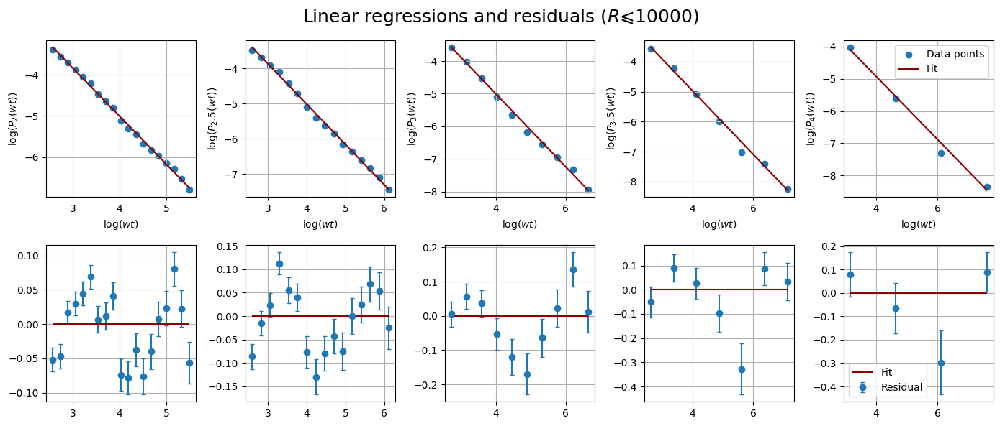

------ Earthquakes with m ≥ 2, R ≤ 10000.0  ------
Slope: -1.168 ± 0.006
Intercept: -0.337 ± 0.022
Pearson coefficient: -1.00
Degrees of freedom: 17
------ Earthquakes with m ≥ 2.5, R ≤ 10000.0  ------
Slope: -1.146 ± 0.008
Intercept: -0.433 ± 0.032
Pearson coefficient: -1.00
Degrees of freedom: 14
------ Earthquakes with m ≥ 3, R ≤ 10000.0  ------
Slope: -1.120 ± 0.012
Intercept: -0.527 ± 0.052
Pearson coefficient: -1.00
Degrees of freedom: 8
------ Earthquakes with m ≥ 3.5, R ≤ 10000.0  ------
Slope: -1.058 ± 0.017
Intercept: -0.743 ± 0.083
Pearson coefficient: -1.00
Degrees of freedom: 5
------ Earthquakes with m ≥ 4, R ≤ 10000.0  ------
Slope: -0.981 ± 0.028
Intercept: -0.993 ± 0.160
Pearson coefficient: -1.00
Degrees of freedom: 2


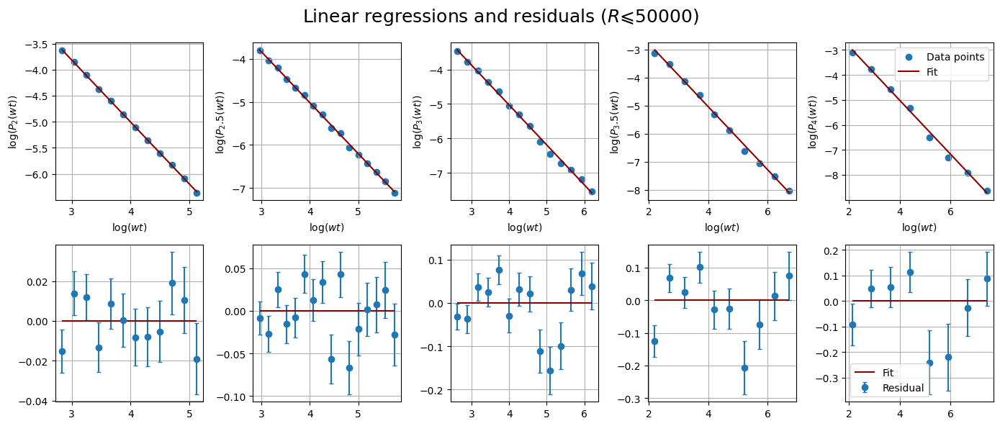

------ Earthquakes with m ≥ 2, R ≤ 50000.0  ------
Slope: -1.189 ± 0.006
Intercept: -0.246 ± 0.021
Pearson coefficient: -1.00
Degrees of freedom: 10
------ Earthquakes with m ≥ 2.5, R ≤ 50000.0  ------
Slope: -1.185 ± 0.008
Intercept: -0.280 ± 0.032
Pearson coefficient: -1.00
Degrees of freedom: 14
------ Earthquakes with m ≥ 3, R ≤ 50000.0  ------
Slope: -1.158 ± 0.010
Intercept: -0.399 ± 0.041
Pearson coefficient: -1.00
Degrees of freedom: 12
------ Earthquakes with m ≥ 3.5, R ≤ 50000.0  ------
Slope: -1.122 ± 0.013
Intercept: -0.550 ± 0.054
Pearson coefficient: -1.00
Degrees of freedom: 8
------ Earthquakes with m ≥ 4, R ≤ 50000.0  ------
Slope: -1.078 ± 0.019
Intercept: -0.709 ± 0.088
Pearson coefficient: -1.00
Degrees of freedom: 6


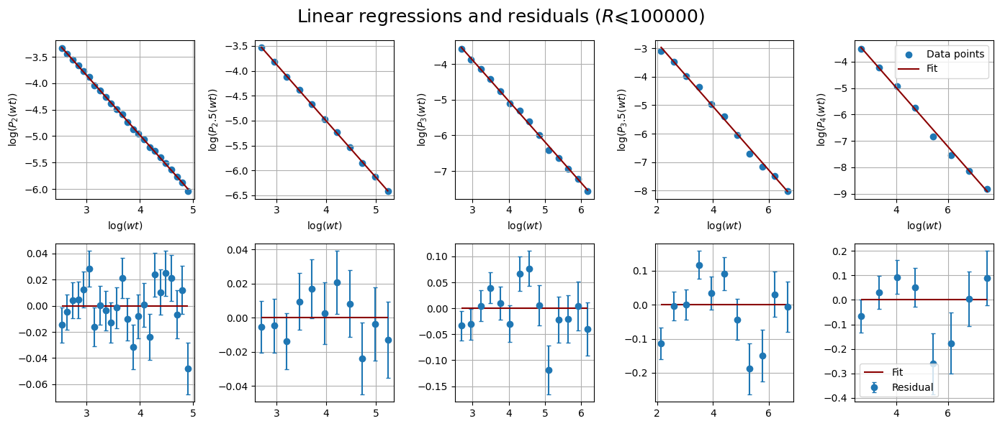

------ Earthquakes with m ≥ 2, R ≤ 100000.0  ------
Slope: -1.128 ± 0.005
Intercept: -0.469 ± 0.017
Pearson coefficient: -1.00
Degrees of freedom: 22
------ Earthquakes with m ≥ 2.5, R ≤ 100000.0  ------
Slope: -1.133 ± 0.007
Intercept: -0.471 ± 0.027
Pearson coefficient: -1.00
Degrees of freedom: 9
------ Earthquakes with m ≥ 3, R ≤ 100000.0  ------
Slope: -1.147 ± 0.009
Intercept: -0.449 ± 0.039
Pearson coefficient: -1.00
Degrees of freedom: 12
------ Earthquakes with m ≥ 3.5, R ≤ 100000.0  ------
Slope: -1.115 ± 0.012
Intercept: -0.581 ± 0.050
Pearson coefficient: -1.00
Degrees of freedom: 9
------ Earthquakes with m ≥ 4, R ≤ 100000.0  ------
Slope: -1.121 ± 0.020
Intercept: -0.494 ± 0.093
Pearson coefficient: -1.00
Degrees of freedom: 6


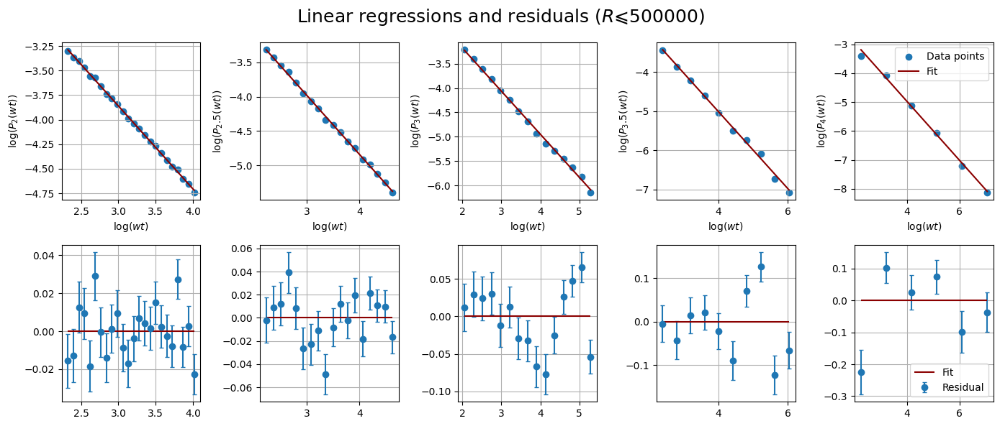

------ Earthquakes with m ≥ 2, R ≤ 500000.0  ------
Slope: -0.844 ± 0.005
Intercept: -1.328 ± 0.016
Pearson coefficient: -1.00
Degrees of freedom: 22
------ Earthquakes with m ≥ 2.5, R ≤ 500000.0  ------
Slope: -0.864 ± 0.005
Intercept: -1.384 ± 0.019
Pearson coefficient: -1.00
Degrees of freedom: 16
------ Earthquakes with m ≥ 3, R ≤ 500000.0  ------
Slope: -0.888 ± 0.007
Intercept: -1.397 ± 0.027
Pearson coefficient: -1.00
Degrees of freedom: 13
------ Earthquakes with m ≥ 3.5, R ≤ 500000.0  ------
Slope: -0.980 ± 0.011
Intercept: -1.095 ± 0.050
Pearson coefficient: -1.00
Degrees of freedom: 8
------ Earthquakes with m ≥ 4, R ≤ 500000.0  ------
Slope: -1.016 ± 0.015
Intercept: -0.911 ± 0.075
Pearson coefficient: -1.00
Degrees of freedom: 4


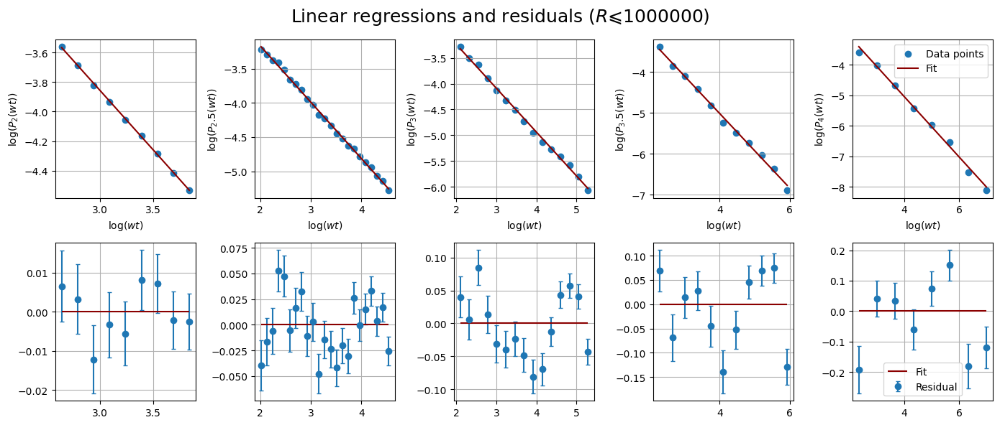

------ Earthquakes with m ≥ 2, R ≤ 1000000.0  ------
Slope: -0.809 ± 0.007
Intercept: -1.432 ± 0.023
Pearson coefficient: -1.00
Degrees of freedom: 7
------ Earthquakes with m ≥ 2.5, R ≤ 1000000.0  ------
Slope: -0.822 ± 0.005
Intercept: -1.525 ± 0.018
Pearson coefficient: -1.00
Degrees of freedom: 21
------ Earthquakes with m ≥ 3, R ≤ 1000000.0  ------
Slope: -0.850 ± 0.006
Intercept: -1.539 ± 0.026
Pearson coefficient: -1.00
Degrees of freedom: 13
------ Earthquakes with m ≥ 3.5, R ≤ 1000000.0  ------
Slope: -0.908 ± 0.010
Intercept: -1.391 ± 0.045
Pearson coefficient: -1.00
Degrees of freedom: 9
------ Earthquakes with m ≥ 4, R ≤ 1000000.0  ------
Slope: -0.990 ± 0.016
Intercept: -1.075 ± 0.077
Pearson coefficient: -1.00
Degrees of freedom: 6


In [ ]:
slopes = [[] for _ in range(len(Radii))]
intercepts = [[] for _ in range(len(Radii))]
sigmas_slope = [[] for _ in range(len(Radii))]
sigmas_intercept = [[] for _ in range(len(Radii))]

for j, radius in enumerate(Radii):

    fit_res = statistic_plots(bins_cut[j], counts_cut[j], magnitudes, errors_cut[j], 'wt', spec = f' ($R\leqslant{radius:.0f}$)')

    for res, m, p in zip(fit_res, magnitudes, pearson_list):
        slope, intercept, pcov, chisquare , dof = res

        slopes[j].append(slope)
        intercepts[j].append(intercept)

        confidence_level = (1.- chi2.cdf(chisquare, dof))*100

        sigma_slope, sigma_intercept = np.sqrt(np.diag(pcov))

        sigmas_slope[j].append(sigma_slope)
        sigmas_intercept[j].append(sigma_intercept)

        print(f"------ Earthquakes with m ≥ {m}, R ≤ {radius}  ------")
        print(f"Slope: {slope:.3f} ± {sigma_slope:.3f}")
        print(f"Intercept: {intercept:.3f} ± {sigma_intercept:.3f}")
        print(f"Pearson coefficient: {p:.2f}")
        print(f"Degrees of freedom: {dof}")

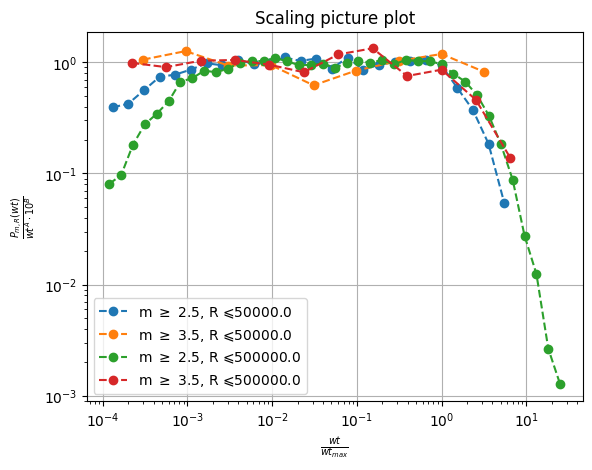

In [ ]:
for i, r in enumerate(Radii):
    for j, (b, c, e, m, last_cut, slope, intercept) in enumerate(zip(bins[i], counts[i], errors[i], magnitudes[:-1], last_cut_list[i], slopes[i], intercepts[i])):
        if i % 2 == 0 or j % 2 == 0:
            continue

        c = c[b >= last_cut-4]
        e = e[b >= last_cut-4]
        b = b[b >= last_cut-4]

        plt.plot(10**b / 10**last_cut, 10**c / 10**(slope * b + intercept), alpha = 1, linestyle = '--', marker = 'o', label = f"m $\geq$ {m}, R $\leqslant {r}$")

plt.xscale('log', base = 10)
plt.yscale('log', base = 10)
plt.xlabel("$\\frac{wt}{wt_{max}}$")
plt.ylabel("$\\frac{P_{m,R}(wt)}{wt^A\cdot10^B}$")
plt.title("Scaling picture plot")
plt.grid()
plt.legend()
plt.show()

## 5.1 Dependence of the fit parameters to m and R

Previously we verified that each distribution obeys a power-law regime in a defined domain of waiting times; now, we ask whether if these power-laws are defined by universal parameters or wheter these parameters depend on $m$ and $R$. To perform this investigation, we display below two heatmaps showing the values of $A$ and $B$ for different $m$ and $R$.

In [ ]:
magnitudes = np.linspace(2, 4.1, 24)
Radii = np.linspace(1e4, 1e6, 24)

bins   = [[] for _ in range(len(Radii))]
counts = [[] for _ in range(len(Radii))]
errors = [[] for _ in range(len(Radii))]
last_cut_list = [[] for _ in range(len(Radii))]

for j, radius in enumerate(Radii):
    for i, m in enumerate(magnitudes):
        dfmr, dd, wt = get_Pmr(df, m, radius)

        b, c, e = log_plot(wt)
        bins[j].append(b)
        counts[j].append(c)
        errors[j].append(e)
        last_cut_list[j].append([])

pearson_list = []

for i, m in enumerate(magnitudes):
    for j, radius in enumerate(Radii):
        bins[j][i], counts[j][i], errors[j][i], pearson = cut_tails(bins[j][i], counts[j][i], errors[j][i], threshold = 2)
        pearson_list.append(pearson[-1])
        last_cut_list[j][i] = bins[j][i][-1]

fits_data = []

for j, radius in enumerate(Radii):

    fit_res = statistic_plots(bins[j], counts[j], magnitudes, errors[j], 'wt', spec = f' ($R\leqslant{radius:.0f}$)', show_plots=False)
    fits_data.append([])

    for res, m, p in zip(fit_res, magnitudes, pearson_list):
        slope, intercept, pcov, chisquare , dof = res

        confidence_level = (1.- chi2.cdf(chisquare, dof))*100

        sigma_slope, sigma_intercept = np.sqrt(np.diag(pcov))
        fits_data[-1].append([slope, intercept, sigma_slope, sigma_intercept])

fits_data = np.array(fits_data)

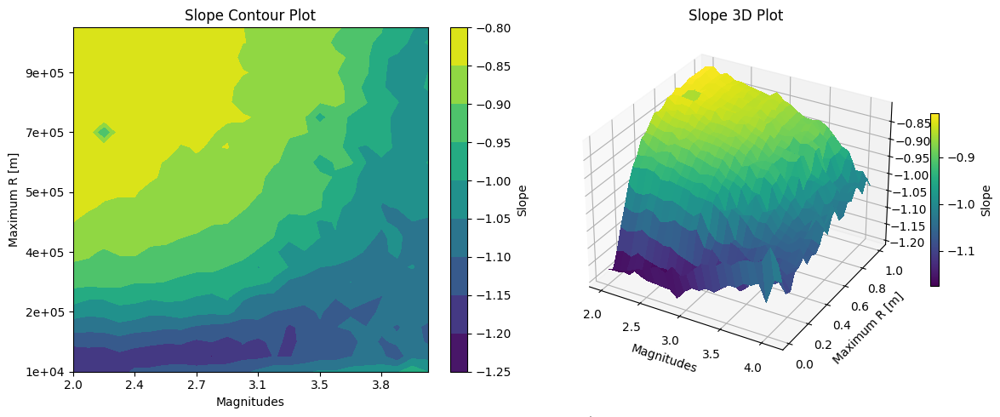

In [ ]:
data_to_plot = fits_data[:,:,0]

fig = plt.figure(figsize=(12,5))

ax1 = fig.add_subplot(1,2,1)
plot1 = ax1.contourf(data_to_plot)
ax1.set_xlabel("Magnitudes")
ax1.set_ylabel("Maximum R [m]")
ax1.set_title("Slope Contour Plot")
fig.colorbar(plot1, ax=ax1, label='Slope')

x_tick_step = 4
y_tick_step = 4
ax1.set_xticks(np.arange(0, len(magnitudes), x_tick_step), ["{:.1f}".format(mag) for mag in magnitudes[::x_tick_step]])
ax1.set_yticks(np.arange(0, len(Radii), y_tick_step), ["{:.0e}".format(r) for r in Radii[::y_tick_step]])


x, y = np.meshgrid(magnitudes, Radii)
ax2 = fig.add_subplot(1,2,2, projection='3d')
scat2 = ax2.plot_surface(x, y, data_to_plot, cmap='viridis', linewidth=0, antialiased=False)
ax2.set_xlabel("Magnitudes")
ax2.set_ylabel("Maximum R [m]")
ax2.set_title("Slope 3D Plot")
fig.colorbar(scat2, ax=ax2, shrink=0.5, label='Slope')

plt.tight_layout()
plt.show()

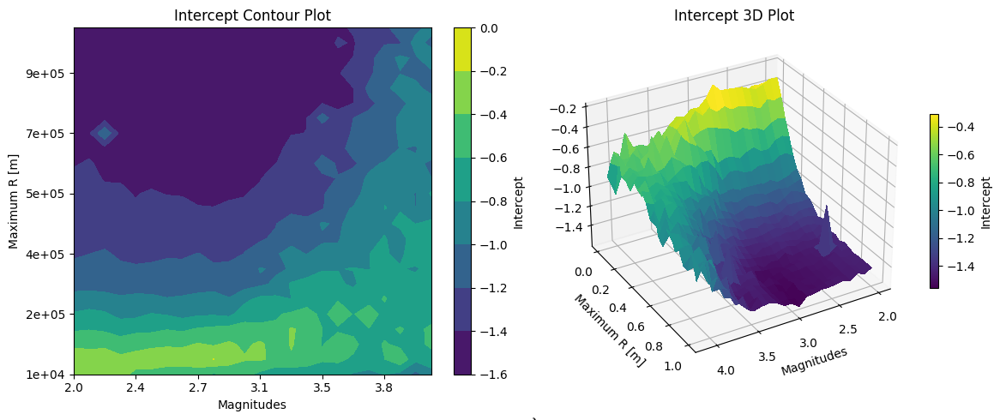

In [ ]:
data_to_plot = fits_data[:,:,1]

fig = plt.figure(figsize=(12,5))

ax1 = fig.add_subplot(1,2,1)
plot1 = ax1.contourf(data_to_plot)
ax1.set_xlabel("Magnitudes")
ax1.set_ylabel("Maximum R [m]")
ax1.set_title("Intercept Contour Plot")
fig.colorbar(plot1, ax=ax1, label='Intercept')

x_tick_step = 4
y_tick_step = 4
ax1.set_xticks(np.arange(0, len(magnitudes), x_tick_step), ["{:.1f}".format(mag) for mag in magnitudes[::x_tick_step]])
ax1.set_yticks(np.arange(0, len(Radii), y_tick_step), ["{:.0e}".format(r) for r in Radii[::y_tick_step]])


x, y = np.meshgrid(magnitudes, Radii)
ax2 = fig.add_subplot(1,2,2, projection='3d')
scat2 = ax2.plot_surface(x, y, data_to_plot, cmap='viridis', linewidth=0, antialiased=False)
ax2.set_xlabel("Magnitudes")
ax2.set_ylabel("Maximum R [m]")
ax2.set_title("Intercept 3D Plot")
ax2.view_init(30,60)
fig.colorbar(scat2, ax=ax2, shrink=0.5, label='Intercept')

plt.tight_layout()
plt.show()

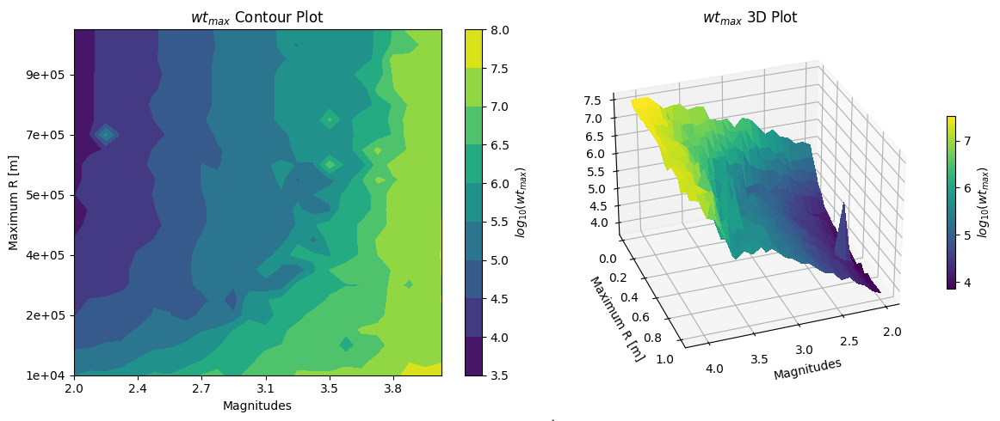

In [ ]:
data_to_plot = np.array(last_cut_list)

fig = plt.figure(figsize=(12,5))

ax1 = fig.add_subplot(1,2,1)
plot1 = ax1.contourf(data_to_plot)
ax1.set_xlabel("Magnitudes")
ax1.set_ylabel("Maximum R [m]")
ax1.set_title("$wt_{max}$ Contour Plot")
fig.colorbar(plot1, ax=ax1, label='$log_{10}(wt_{max})$')

x_tick_step = 4
y_tick_step = 4
ax1.set_xticks(np.arange(0, len(magnitudes), x_tick_step), ["{:.1f}".format(mag) for mag in magnitudes[::x_tick_step]])
ax1.set_yticks(np.arange(0, len(Radii), y_tick_step), ["{:.0e}".format(r) for r in Radii[::y_tick_step]])


x, y = np.meshgrid(magnitudes, Radii)
ax2 = fig.add_subplot(1,2,2, projection='3d')
scat2 = ax2.plot_surface(x, y, data_to_plot, cmap='viridis', linewidth=0, antialiased=False)
ax2.set_xlabel("Magnitudes")
ax2.set_ylabel("Maximum R [m]")
ax2.set_title("$wt_{max}$ 3D Plot")
ax2.view_init(30,70)
fig.colorbar(scat2, ax=ax2, shrink=0.5, label='$log_{10}(wt_{max})$')

plt.tight_layout()
plt.show()

From these plots we can see a dependence of the parameters with respect to $m$ and $R$. We can conclude that the power-laws are not universal, but one can try to extrapolate an empirical law through a curve fit on these maps (probably a quadratic one is a good approximation given the shape of the heatmaps).

# 6. Tree structure

In the present section we analyze the tree structure emerging from the causality relations between earthquakes. Specifically the second column of the dataset presents the index of the so-called "father" earthquake, that is the event which triggered the present one.
It is then possible to draw graphs that represent the connections between different seismic events, employing of the networkx package.

(70775, 16)


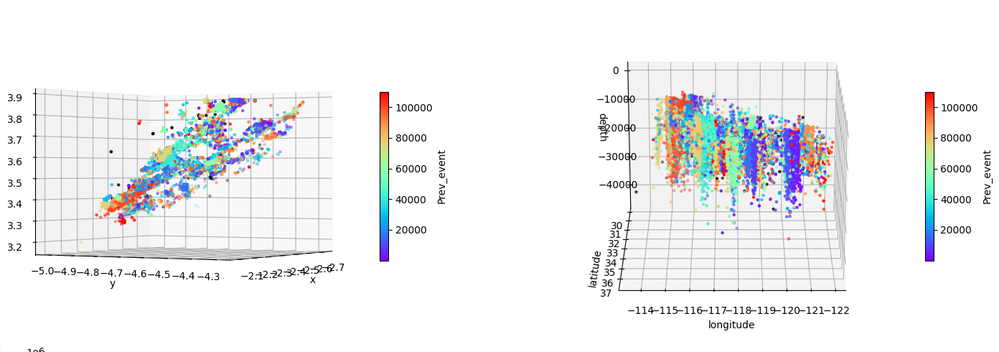

In [ ]:
df_0 = df[df['Prev_event'] > 0]
df_1 = df[df['Prev_event'] == 0]
print(np.shape(df_0))

fig = plt.figure(figsize=(16,5))

ax1 = fig.add_subplot(1, 2, 1, projection='3d')
scatter1_1 = ax1.scatter(df_0['x'], df_0['y'], df_0['z'], c=df_0['Prev_event'], cmap='rainbow', marker='.')
scatter1_2 = ax1.scatter(df_1['x'], df_1['y'], df_1['z'], c='black', marker='.')
fig.colorbar(scatter1_1, label='Prev_event', shrink=0.5)
ax1.set_xlabel('x')
ax1.set_ylabel('y')
ax1.set_zlabel('z')
ax1.view_init(0,30)

ax2= fig.add_subplot(1, 2, 2, projection='3d')
scatter2_1 = ax2.scatter(df_0['lon'], df_0['lat'], df_0['dep'], c=df_0['Prev_event'], cmap='rainbow', marker='.')
scatter2_2 = ax2.scatter(df_1['lon'], df_1['lat'], df_1['dep'], c='black', marker='.')
fig.colorbar(scatter2_1, label='Prev_event', shrink=0.5)
ax2.set_xlabel('longitude')
ax2.set_ylabel('latitude')
ax2.set_zlabel('depth')
ax2.view_init(20,90)

plt.tight_layout()

In [ ]:
df['Fol event'] = [[] for _ in range(len(df))]

for i in df['Index']:
    if df['Prev_event'][i] > -1:
        df['Fol event'][df['Prev_event'][i]].append(i)
df

,Index,Prev_event,Time,Magnitude,x,y,z,Waiting time prev,Distances prev,Waiting time,Distances,r,lat,lon,dep,Animation_frame,Fol event
0,0,-1,0.000000e+00,2.71,-2571956,-4627162,3520602,0.00000,0.000000,0.00000,0.000000,6.357690e+06,33.624997,-119.067002,-13309.831190,0.0,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14..."
1,1,0,3.650139e+04,2.12,-2363740,-4787011,3461373,36501.39072,269097.900211,36501.39072,269097.900211,6.362692e+06,32.957092,-116.279332,-8308.419635,0.0,[]
2,2,0,3.748828e+04,2.33,-2363746,-4786942,3461232,37488.27744,269083.350284,986.88672,157.092330,6.362565e+06,32.956316,-116.279718,-8434.808059,0.0,[]
3,3,0,4.798252e+04,2.57,-2475085,-4664024,3548479,47982.51648,107330.912667,10494.23904,187395.962214,6.361672e+06,33.903121,-117.953814,-9328.140870,0.0,[]
4,4,0,6.026857e+04,2.98,-2238642,-4839098,3469546,60268.57056,398273.531418,12286.05408,304608.956227,6.361300e+06,33.053002,-114.825995,-9700.061789,0.0,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110266,110266,-1,9.304996e+08,2.60,-2668492,-4335735,3810743,0.00000,0.000000,3356.50176,639785.444677,6.359340e+06,36.815170,-121.610832,-11659.644559,200.0,[]
110267,110267,-1,9.305115e+08,2.02,-2297480,-4823870,3445285,0.00000,0.000000,11936.55744,713782.342268,6.357525e+06,32.814599,-115.467209,-13474.942360,200.0,[]
110268,110268,-1,9.305318e+08,2.00,-2404797,-4441247,3868121,0.00000,0.000000,20291.00544,580265.095895,6.361610e+06,37.448003,-118.434166,-9389.858152,200.0,[]
110269,110269,-1,9.305363e+08,2.17,-2388375,-4691191,3550903,0.00000,0.000000,4472.86752,404189.243726,6.349844e+06,34.001254,-116.981514,-21155.887385,200.0,[]


We subsequently define the function VisualizeTree() to select, given a starting point in the earthquake event chain, only the rows of the dataframe which represent its descendants. The number of generations to select is also given as an input of the function.

In [ ]:
df['Generation'] = df['Index']

def VisualizeTree(df_tree, father_index:int, number_gen:int):

  generation = 0
  df_new = df[df['Index'] == father_index]
  df_new.loc[father_index, ('Generation')] = generation

  while generation < number_gen:
    list_check = [ind for single_list in df_new[df_new['Generation'] == generation].loc[:, ('Fol event')] for ind in single_list]
    #print(list_check)
    generation += 1
    for ind in list_check:
      df_new = pd.concat((df_new, df[df['Index'] == ind]), axis=0)
      df_new.loc[ind, ('Generation')] = generation

  return df_new

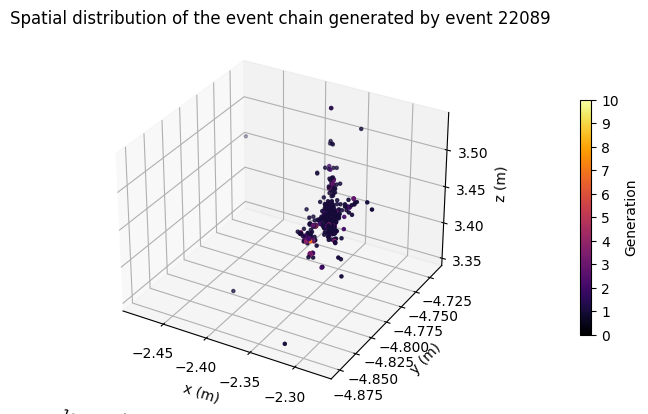

In [ ]:
father_index = 22089
number_gen=10

df_new = VisualizeTree(df, father_index, number_gen)

fig = plt.figure(figsize=(6,5))
ax = fig.add_subplot(1,1,1, projection='3d')
scatter = ax.scatter(df_new.loc[:, ('x')], df_new.loc[:, ('y')], df_new.loc[:, ('z')], c=df_new.loc[:, ('Generation')], cmap='inferno', marker='.')
ax.set_xlabel('x (m)')
ax.set_ylabel('y (m)')
ax.set_zlabel('z (m)')
ax.set_title('Spatial distribution of the event chain generated by event '+str(father_index))
fig.colorbar(scatter, shrink=0.5, label='Generation', ticks=[i for i in range(number_gen+1)], pad=0.2)
plt.tight_layout()
plt.show()

We then select the events with a number of "sons" greater than 10 and plot the corresponding indices, in order to get a general idea of their distribution.

In [ ]:
#Let's select only the events with the a number of sons bigger than 10
indices = []
sons = []

for i in range(len(df)):
    if len(df['Fol event'][i]) > 10:
        indices.append(df['Index'][i])
        sons.append(df['Fol event'][i])

print('Number of selected earthquakes:', len(indices))
print(indices, sons)

Number of selected earthquakes: 394
[0, 1091, 1151, 1268, 2014, 2442, 2867, 3599, 3658, 3705, 4040, 4125, 4226, 4543, 4652, 5057, 5115, 5310, 6670, 7032, 8283, 8525, 8830, 8841, 9074, 9744, 10066, 10725, 11207, 11603, 11651, 11737, 14073, 14074, 14097, 14101, 14102, 14109, 14240, 14309, 14368, 14763, 14848, 15010, 15271, 15563, 15962, 15968, 15981, 17407, 18732, 18767, 20139, 21241, 21361, 21867, 21877, 22089, 22904, 23103, 23428, 24334, 24749, 24751, 24795, 26481, 26669, 26736, 27410, 28467, 28800, 29461, 31067, 31852, 32466, 32541, 32568, 32593, 32706, 33176, 33911, 35587, 36462, 36957, 37455, 37461, 37462, 37548, 37566, 37600, 37687, 37740, 37880, 38014, 38186, 38267, 38325, 38521, 38546, 38781, 38889, 38938, 39125, 39243, 39602, 39805, 39806, 39845, 39854, 39859, 39870, 39892, 39904, 39928, 39955, 40055, 40206, 40329, 40356, 40490, 40517, 40525, 40584, 40587, 40608, 40640, 40657, 40736, 41095, 41111, 41198, 41269, 41272, 41304, 41314, 41496, 41530, 41576, 41578, 42248, 42306, 42310

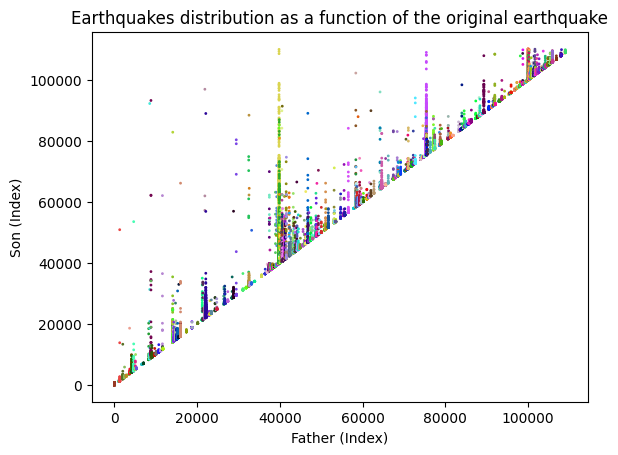

In [ ]:
list_ = [len(sons[i]) for i in range(len(indices))]

store = []

for i in indices:
    rand = np.random.uniform()

    color = np.random.rand(3)
    index = [i for _ in range(len(df['Fol event'][i]))]
    store.append(index)

    plt.scatter(index, df['Fol event'][i], color = [color]*len(index), s = 1)

plt.xlabel('Father (Index)')
plt.ylabel('Son (Index)')
plt.title('Earthquakes distribution as a function of the original earthquake')
plt.show()

It is finally possible to plot the tree structure with the networkx package. We chose two different layouts, one linear (similar to the typical Neural Network layered representations) and the other radial. We chose to plot three different event chains, with different lengths and node quantities.

In [ ]:
G = nx.DiGraph()

num_gen = 4
father_node = 1091
father_name = str(father_node)

def plot_children(G, df_new, n0, j):
  if len(df_new['Fol event'].iloc[j]) > 0:
    for i in df_new['Fol event'].iloc[j]:
      num_gen = df_new['Generation'].iloc[j]
      var_name = str(i)
      G.add_node(var_name)
      G.add_edge(n0, var_name)


df_new = VisualizeTree(df, father_node, num_gen)

for j in range(0, np.shape(df_new)[0]):
  node_name = str(df_new['Index'].iloc[j])
  plot_children(G, df_new, node_name, j)

In [ ]:
options = {
    'node_size':210,
    'width':0.2,
    'font_size':8,
    'node_color' : 'lightblue'
}

/usr/local/lib/python3.10/dist-packages/pygraphviz/agraph.py:1407: RuntimeWarning:





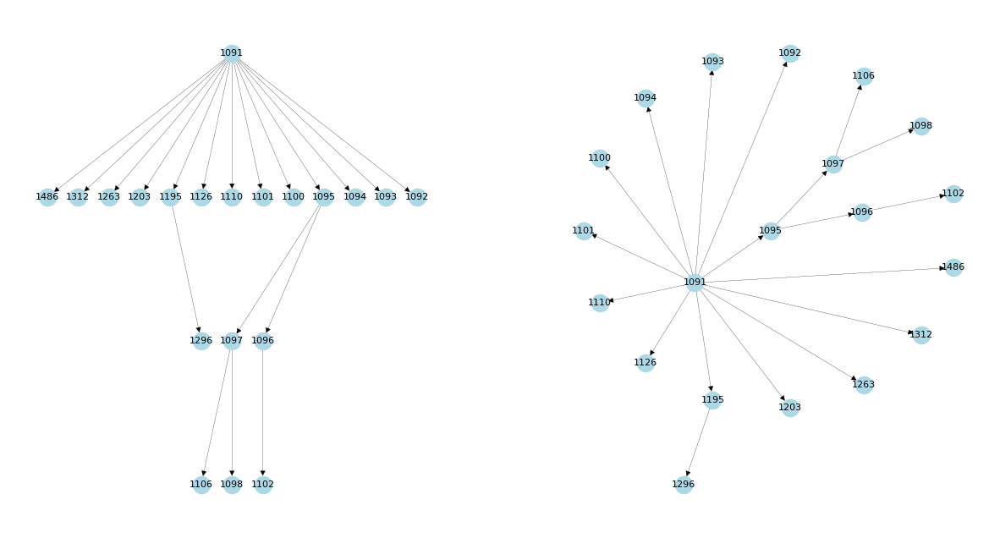

In [ ]:
for i, layer in enumerate(nx.topological_generations(G)):
    for n in layer:
        G.nodes[n]["layer"] = i
pos = nx.multipartite_layout(G, subset_key="layer", align="horizontal")
for k in pos:
    pos[k][-1] *= -1


fig = plt.figure(figsize=(15,8))

ax1 = fig.add_subplot(121)
nx.draw(G, with_labels=True, pos=pos, **options, ax = ax1)

ax2 = fig.add_subplot(122)
# Nodes layout/ position
fixed_positions = {0:(0,0)}
fixed_nodes = fixed_positions.keys()
center_node = 1091 # Or any other node to be in the center
edge_nodes = set(G) - {center_node}
pos[center_node] = np.array([0,0])
pos = nx.nx_agraph.graphviz_layout(G, prog="twopi", root=0)
nx.draw(G, pos, with_labels = True, ax = ax2, **options)

plt.show()

/usr/local/lib/python3.10/dist-packages/pygraphviz/agraph.py:1407: RuntimeWarning:





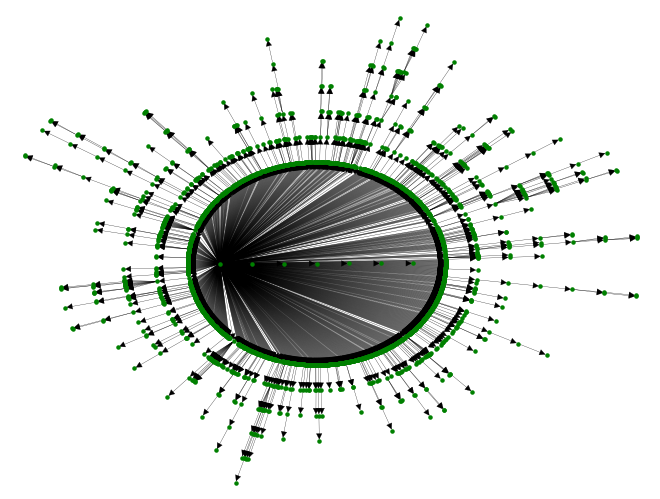

In [ ]:
G = nx.DiGraph()

num_gen = 6
father_node = 22089
father_name = str(father_node)

df_new = VisualizeTree(df, father_node, num_gen)

for j in range(0, np.shape(df_new)[0]):
  node_name = str(df_new['Index'].iloc[j])
  plot_children(G, df_new, node_name, j)

options = {
    'node_size':5,
    'width':0.2,
    'font_size':8,
    'node_color' : 'green'
          }

#fig = plt.figure(figsize=(10,15))

pos = nx.nx_agraph.graphviz_layout(G, prog="twopi", root=0)
nx.draw(G, pos, **options, with_labels = False)
xmax = 1.02 * max(xx for xx, yy in pos.values())
ymax = 1.02 * max(yy for xx, yy in pos.values())
plt.xlim(0, xmax)
plt.ylim(0, ymax)

plt.show()

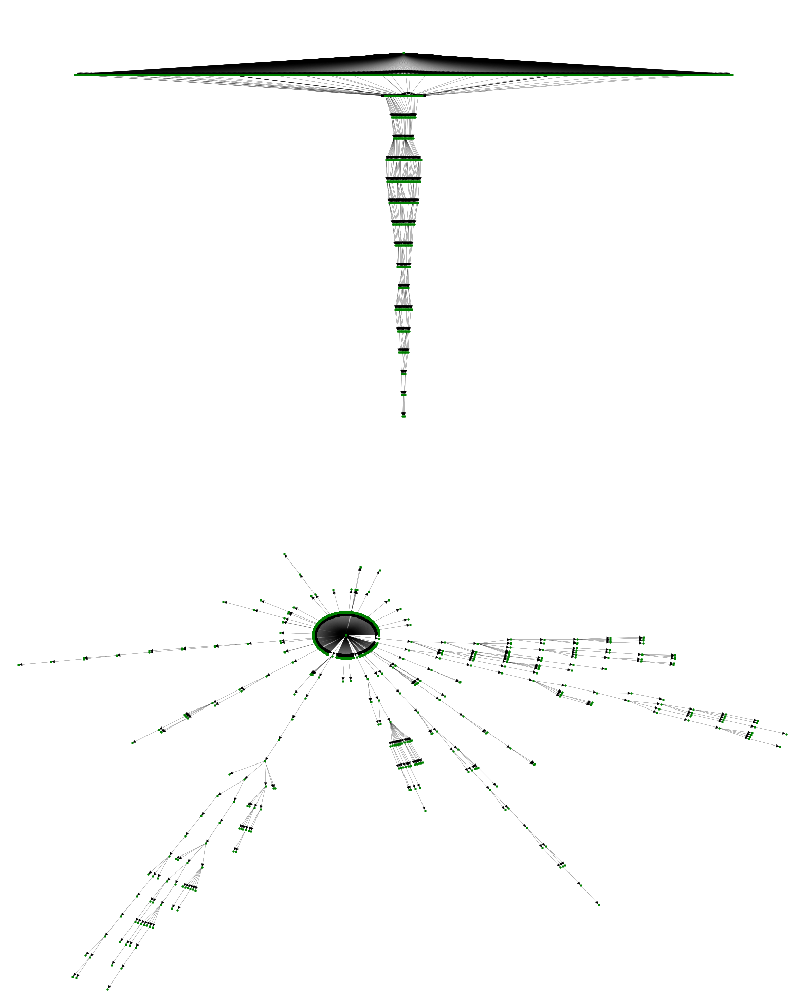

In [ ]:
G = nx.DiGraph()

num_gen = 20
father_node = 0
father_name = str(father_node)


df_new = VisualizeTree(df, father_node, num_gen)

for j in range(0, np.shape(df_new)[0]):
  node_name = str(df_new['Index'].iloc[j])
  plot_children(G, df_new, node_name, j)

########### PLOT for 0 ##############
for i, layer in enumerate(nx.topological_generations(G)):
    for n in layer:
        G.nodes[n]["layer"] = i
pos = nx.multipartite_layout(G, subset_key="layer", align="horizontal")
for k in pos:
    pos[k][-1] *= -1

options = {
    'node_size':5,
    'width':0.2,
    'font_size':8,
    'node_color' : 'green'
          }

fig = plt.figure(figsize=(20,25))

ax1 = fig.add_subplot(211)
nx.draw(G, with_labels=False, pos=pos, **options, ax = ax1)

ax2 = fig.add_subplot(212)
pos = nx.nx_agraph.graphviz_layout(G, prog="twopi", root=0)
nx.draw(G, pos, **options, with_labels = False, ax = ax2)
xmax = 1.02 * max(xx for xx, yy in pos.values())
ymax = 1.02 * max(yy for xx, yy in pos.values())
plt.xlim(0, xmax)
plt.ylim(0, ymax)

plt.show()